In this work, we consider the absorption and scattering of thermal neutrons through a slab of shielding material(s) of thickness $L$. This simulation can be useful while designing a shielding layer for a nuclear reactor, the job of which is to reduce neutron radiation, to estimate the probability rate of each process.

In [ ]:
import time # for speed comparison of a certain function
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches # for custom legends
from matplotlib.lines import Line2D # for custom legends
from mpl_toolkits.mplot3d import Axes3D # for 3D plotting
from tqdm.notebook import tqdm # for progress bars
from scipy.constants import Avogadro as AVOGADRO_CONSTANT
%matplotlib inline

First, we create a template for a generic material class - as usual in nuclear physics, in CGS units.

Besides high-school chemistry quantities, the total cross section $\Sigma_{tot}$ for $N$ processes is given by $$\Sigma_{tot} = \sum_{i=1}^N \sigma_i,$$ where $\sigma_i$ is the cross section for the $i$-th process.

Accordingly, the probability of a neutron to undergo the $i$-th process is given by $P(i)=\frac{\sigma_i}{\Sigma_{tot}}$.

The nominal free path for the $i$-th process is defined $\lambda_i=\frac{1}{n\sigma_i}$, where $n$ is the number density of molecules participating in that process, while $\lambda_{tot}=\frac{1}{\Sigma_{tot}}$.

In [ ]:
class Material:
    """
    A class that represents a generic material.
    Except cases are handled for vacuum.

    Attributes:
    -----------
    name : str
        The name of the material.
    absorption_x_section : float
        The absorption cross-section of the material in cm^2.
    scattering_x_section : float
        The scattering cross-section of the material in cm^2.
    density : float
        The density of the material in g/cm^3.
    molar_mass : float
        The molar mass of the material in g/mol.
    molar_density : float
        The molar density of the material in mol/cm^3.
    number_density : float
        The number density of the material in molecules/cm^3.

    Properties:
    -----------
    total_section : float
        The total cross-section of the material in cm^2.
    absorption_nominal_free_path : float
        The absorption nominal free path of the material in cm.
    mean_path : float
        The mean path of the material in cm.
    absorption_probability : float
        The absorption probability of the material.
    scattering_probability : float
        The scattering probability of the material.

    Methods:
    --------
    __str__():
        Returns the name of the material as a string.
    """

    def __init__(
        self,
        name: str,
        absorption_x_section: float,
        scattering_x_section: float,
        density: float,
        molar_mass: float,
    ):
        self.name = name
        self.absorption_x_section = absorption_x_section
        self.scattering_x_section = scattering_x_section
        self.density = density
        self.molar_mass = molar_mass
        try:
            self.molar_density = self.density / self.molar_mass * AVOGADRO_CONSTANT
        # Or, in the case of vacuum, the molar density is infinite
        except ZeroDivisionError:
            self.molar_density = np.inf
        try:
            self.number_density = (self.density * AVOGADRO_CONSTANT) / self.molar_mass
        except ZeroDivisionError:
            self.number_density = np.inf

    def __str__(self):
        """
        Returns the name of the material as a string.
        """
        return f"{self.name}"

    @property
    def total_section(self):
        """
        Returns the total cross-section of the material in cm^2.
        """
        return self.absorption_x_section + self.scattering_x_section

    @property
    def absorption_nominal_free_path(self):
        """
        Returns the absorption nominal free path of the material in cm.
        """
        return 1 / (self.number_density * self.absorption_x_section)

    @property
    def mean_path(self):
        """
        Returns the mean path of the material in cm.
        """
        if self.number_density == np.inf:
            return np.inf
        else:
            return 1 / (self.number_density * self.total_section)

    @property
    def absorption_probability(self):
        """
        Returns the absorption probability of the material.
        """
        try:
            return self.absorption_x_section / self.total_section
        except ZeroDivisionError:
            return 0

    @property
    def scattering_probability(self):
        """
        Returns the scattering probability of the material.
        """
        try:
            return self.scattering_x_section / self.total_section
        except ZeroDivisionError:
            return 0


Then, we create the materials used in the experiments below, where $\sigma$'s are originally given in barns. These properties determine the rates of each process. We consider water, lead and graphite. Additionally, we implement a vacuum material which will be useful later.

In [ ]:
WATER = Material(
    name="Water",
    absorption_x_section=0.662e-24,
    scattering_x_section=103e-24,
    density=1.0,
    molar_mass=18.0153,
)

LEAD = Material(
    name="Lead",
    absorption_x_section=0.158e-24,
    scattering_x_section=11.211e-24,
    density=11.35,
    molar_mass=207.2,
)

GRAPHITE = Material(
    name="Graphite",
    absorption_x_section=0.0045e-24,
    scattering_x_section=4.74e-24,
    density=1.67,
    molar_mass=12.011,
)

VACUUM = Material(
    name="Vacuum",
    absorption_x_section=0,
    scattering_x_section=0,
    density=0,
    molar_mass=0,
)


## A Preamble on Monte Carlo Methods

Monte Carlo (MC) methods are a class of computational algorithms that rely on random sampling to obtain numerical results. Originating in nuclear physics, hey are particularly useful for simulating complex systems or solving problems that have a probabilistic interpretation. Invented by Stanislaw Ulam and John von Neumann, the methods are named after Monaco's Monte Carlo Casino.

**Mathematics of MC Methods**

The basic idea behind Monte Carlo methods is to approximate an unknown quantity by generating random samples and then using the sample statistics as an estimate of the true value. For example, consider evaluating a definite integral:
$$I=\int_a^bf(x)dx.$$

We can approximate this integral using the MC method as follows:

- 1. Generate $N$ random samples $x_i$ from a uniform distribution in the interval $[a, b]$.
- 2. Evaluate $f(x_i)$ for each sample $x_i$.
- 3. Calculate the average value of $f(x_i)$: $$\bar{f}=\frac{1}{N}\sum_{i=1}^Nf(x_i).$$
- 4. Estimate the integral $I$ by multiplying the average value by the width of the interval: $$I\approx (b-a)\bar{f}.$$

As $N$ increases, the approximation converges to the true value of the integral.

**Advantages**

- 1. Simplicity: The algorithms are often easy to understand and implement.
- 2. Scalability: Monte Carlo methods can be applied to problems with high dimensionality or complexity.
- 3. Robustness: The methods are less sensitive to the choice of numerical parameters and can handle discontinuities and singularities in the function.
- 4. Pathological Functions: Monte Carlo methods are useful for approximating integrals of pathological functions, where using equally spaced points can result in completely wrong approximations. This is because random sampling avoids systematic errors that might occur with deterministic methods.
- 5. Curse of Dimensionality: MC methods effectively address the resource-exhaustive exponential growth as problem dimensionality increases. The curse of dimensionality refers to exponential computational resource requirements with increased problem dimensions. Traditional numerical methods, such as the trapezoidal rule or Simpson's rule, suffer from this curse as the number of function evaluations required increases exponentially with the number of dimensions. Since the convergence rate of MC methods does not depend on the dimensionality, the same number of random samples can often provide similar accuracy for problems with various dimensions


**Disadvantages**

- 1. Convergence: The convergence rate can be slow, and the error decreases only as $\frac{1}{\sqrt{N}}$, where $N$ is the number of samples.
- 2. Efficiency: In some cases, other numerical methods can provide more accurate results with fewer computations.
- 3. Randomness: The use of random numbers can lead to different results each time the algorithm is run, which may be undesirable in some applications.

## The (simplified) von Neumann Rejection Method

The von Neumann rejection method, also known as the acceptance-rejection method, is a technique used in Monte Carlo simulations for generating random numbers from a desired probability distribution. The method was developed by John von Neumann in the early 1950s and has since become a widely-used tool in computational statistics. In its simplified version, the method is particularly useful when we want to generate random samples from a probability density function $f(x)$ in a specific interval $a < x < b$.

The von Neumann rejection method works by generating random numbers from an easy-to-sample distribution (called the proposal distribution) and then rejecting or accepting each sample based on a comparison with the target distribution. The simplified von Neumann rejection method can be summarized as follows:

- 1. Define the target probability density function $f(x)$ for the interval $a < x < b$. Determine the maximum value of the function in this interval, denoted as $y$.
- 2. Generate a random sample $x_i$ from the uniform distribution in the interval $a < x < b$.
- 3. Calculate the value of the probability density function for this sample, $f(x_i)$.
- 4. Generate a random sample $y_i$ from the uniform distribution in the interval $0 < y_i < y$.
- 5. If $y_i < f(x_i)$, accept the sample $(x_i, y_i)$ as a valid point. Otherwise, reject the sample and return to step 2.

**Example:** Suppose we want to generate random numbers from the target distribution $f(x) = 2x$ for $0 \leq x \leq 1$. In this case, the maximum value of the function in this interval is $y = 2$. Following the algorithm:

- 1. Generate a random sample $x_i$ from the uniform distribution $U(0, 1)$.
- 2. Calculate the value of the probability density function for this sample, $f(x_i) = 2x_i$.
- 3. Generate a random sample $y_i$ from the uniform distribution $U(0, 2)$.
- 4. If $y_i < 2x_i$, accept the sample $(x_i, y_i)$ as a valid point. Otherwise, reject the sample and return to step 1.

Repeating this process will yield a set of accepted samples that approximate the target distribution $f(x) = 2x$.

**Advantages and Disadvantages**

The simplified von Neumann rejection method offers some advantages:

- 1. Flexibility: The method can generate random numbers from a wide variety of target distributions.
- 2. Simplicity: The algorithm is relatively simple and easy to implement.

However, the method also has some disadvantages:

- 1. Efficiency: The method can be inefficient if the maximum value of the function $y$ is much larger than the average value of $f(x)$ in the interval $a < x < b$. A large proportion of samples may be rejected, resulting in wasted computational resources.

We will use the simplified von Neumann method in order to determine whether the neutron is absorbed (if the sampled number is below a threshold) or scattered.

## Generating Random Numbers

Random number generators (RNGs) play a crucial role in Monte Carlo methods, as they provide the random samples needed for various simulation and estimation tasks. In this context, Python and the Numpy library offer various tools for generating random numbers.

Computers, by their deterministic nature, cannot generate truly random numbers. Instead, they rely on deterministic algorithms to produce sequences of numbers that appear to be random. These numbers are called pseudo-random numbers, as they only mimic true randomness.

Pseudo-random numbers are generated using deterministic algorithms that take an initial value (called the seed) and produce a sequence of numbers that are statistically indistinguishable from a truly random sequence. The quality of a pseudo-random number generator depends on the algorithm used and the properties of the generated sequence, such as uniformity, independence, and period length.

**Lehmer's Linear Congruential Generator**

One of the oldest and most widely-used pseudo-random number generators is Lehmer's Linear Congruential Generator (LCG). The LCG algorithm generates a sequence of random numbers $x_1, x_2, \dots, x_n$ using the following recurrence relation: $$x_{i+1}=(ax_i+c)\mod{m},$$where $x_i$ is the current number in the sequence, $a$ is the multiplier, $c$ is the increment, and $m$ is the modulus. The choice of these parameters significantly affects the quality of the generated sequence.

**Advantages**

- 1. Simplicity: The algorithm is easy to understand and implement.
- 2. Speed: LCGs are typically fast, making them suitable for large-scale simulations and Monte Carlo methods.

**Advantages**

- 1. Period Length: The maximum period length of an LCG is $m$, which can be relatively short for some parameter choices. A short period may lead to repetitive patterns in the generated sequence, affecting the quality of the random numbers.
- 2. Correlations: LCGs may exhibit correlations between successive numbers or in higher dimensions, which can introduce biases in Monte Carlo simulations.
- 3. Cryptographic Security: LCGs are not suitable for cryptographic applications, as their deterministic nature and simple structure make them vulnerable to attacks.

In Python, built-in `random` module and Numpy's `numpy.random` module both provide functions to generate pseudo-random numbers for various distributions. These libraries use different algorithms, such as the Mersenne Twister or the Permuted Congruential Generator, which offer better statistical properties and longer periods than Lehmer's LCG.

In this example, we test whether numbers produced with `numpy.random.uniform()` are uniform over a chosen range. We create four histograms with different numbers of samples and intervals to observe the uniformity of the generated data. The standard deviation for each bin, represented by error bars, reflects the variability of the counts across the bins. These error bars are calculated as the square root of the respective counts, which is a common approach when dealing with count data because the variance of a Poisson distribution is equal to its mean. When generating random numbers from a uniform distribution, the number of counts in each bin of a histogram follows a Poisson distribution (which is a good approximation for a Binomial distribution when $np$ and $n(1-p)$ are both large). The Poisson distribution is commonly used to model the distribution of events occurring independently and at a constant rate. In this case, the "events" are the random numbers falling into each bin of the histogram.

The standard deviation of a Poisson distribution is equal to the square root of the mean, which in this context means that the error in the count of each bin can be approximated by the square root of the counts in that bin.

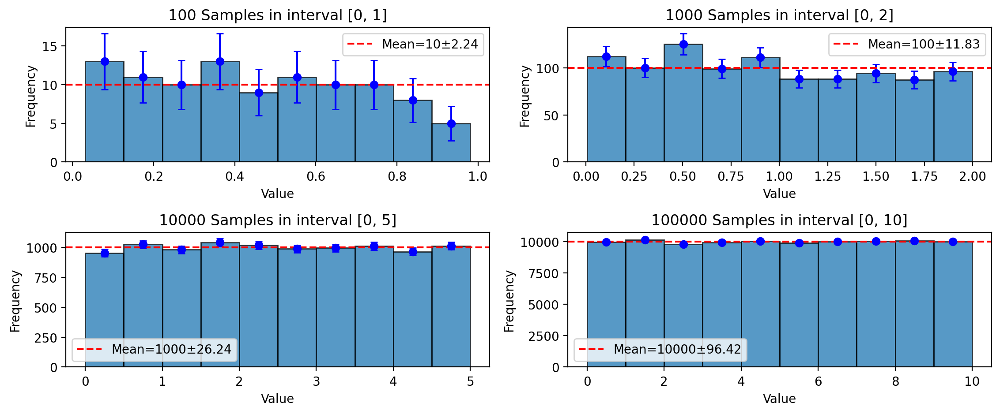

In [ ]:
# Define the number of samples, bins, and interval for each plot
samples = [100, 1000, 10000, 100000]
bins = 10
intervals = [[0, 1], [0, 2], [0, 5], [0, 10]]

# Create a figure with four subplots
fig, axes = plt.subplots(2, 2, figsize=plt.figaspect(0.42), dpi = 200)

# Loop over the subplots and generate random samples
for i, ax in enumerate(axes.flat):
    # Generate random samples using numpy.random.uniform()
    data = np.random.uniform(intervals[i][0], intervals[i][1], samples[i])

    # Create a histogram with the specified number of bins
    counts, edges, _ = ax.hist(data, bins=bins, edgecolor='black', alpha=0.75)

    # Calculate the mean and standard deviation of the counts
    mean_counts = np.mean(counts)
    std_counts = np.std(counts)

    # Calculate the error bars as the square root of the counts
    errors = np.sqrt(counts)
    bin_centers = (edges[:-1] + edges[1:]) / 2

    # Add error bars to the histogram
    ax.errorbar(bin_centers, counts, yerr=errors, fmt='o', capsize=3, color='blue')

    # Add a dashed line for the mean of the counts
    ax.axhline(mean_counts, color='r', linestyle='--',
               label=f'Mean={mean_counts:.0f}±{std_counts:.2f}')

    # Set the title and labels for the subplot
    ax.set_title(f'{samples[i]} Samples in interval {intervals[i]}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

    # Add a legend to the subplot
    ax.legend()

# Set the layout of the figure and display it
plt.tight_layout()
plt.show()


As demonstrated in the plots, the uniformity of the generated distribution increases with the number of generated samples, emphasizing the importance of using a sufficient number of samples for a given Monte Carlo process. This effect is especially evident in the top-left plot, where the fluctuations are more pronounced due to the smaller number of samples, and for some bins, the standard deviation of the frequency will not be within the mean value. Additionally, we see that the higher the number of sampled points, the smaller the relative error for each bin, and the relative variance of the mean value of the histogram.

A **spectral test** is a statistical test used to evaluate the quality of random number generators. It is particularly important for assessing the uniformity and independence of the generated random numbers. In a spectral test, the random numbers are mapped onto a multi-dimensional space, and the distribution of these points is analyzed. The goal is to identify any patterns, correlations, or regularities in the distribution that might indicate non-random behavior. The spectral test is crucial in ensuring that random number generators produce output that closely approximates true random behavior, especially when applied to large data sets or high-dimensional problems. Good random number generators should produce numbers that are uniformly distributed and independent, with no discernible patterns or correlations. These properties are essential for many applications, such as Monte Carlo simulations.

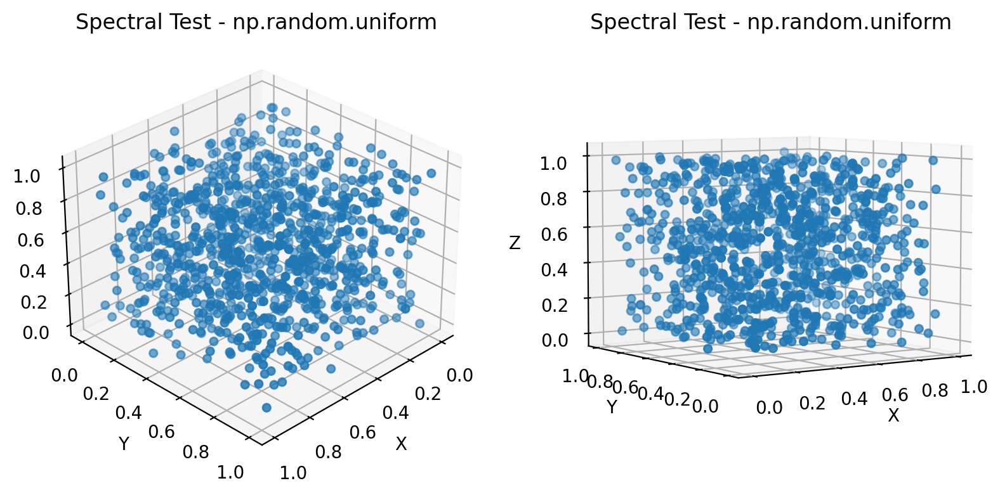

In [ ]:
def get_uniform_distribution(num_points=1000, num_dimensions=3):
    """
    Generates an array of randomly distributed points in the given number of dimensions.

    Parameters:
    -----------
    num_points : int, optional, default: 1000
        The number of points to generate.
    num_dimensions : int, optional, default: 3
        The number of dimensions to generate the points in.

    Returns:
    --------
    points : numpy.ndarray
        An array of shape (num_points, num_dimensions) containing the randomly generated points.
    """
    points = np.random.uniform(low=0, high=1, size=(num_points, num_dimensions))
    return points


# Generate the random points and plot them
random_points_numpy = get_uniform_distribution()
fig = plt.figure(figsize=plt.figaspect(0.5), dpi=200)  # Set the DPI of the figure
ax = fig.add_subplot(121, projection="3d")
ax.scatter(
    random_points_numpy[:, 0], random_points_numpy[:, 1], random_points_numpy[:, 2]
)
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.set_title("Spectral Test - np.random.uniform")
ax.view_init(elev=30, azim=45)  # Set the angles for the 3D figure


ax = fig.add_subplot(122, projection="3d")
ax.scatter(
   random_points_numpy[:, 0], random_points_numpy[:, 1], random_points_numpy[:, 2]
)
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.set_title("Spectral Test - np.random.uniform")
ax.view_init(elev=5, azim=235.5)


We see that the points seem to be distributed uniformly from any angle, and there are no evident spectral issues.

As a counterexample, let's look at the RANDSSP (RAND Simple Serial Pseudo-random) Multiplicative Congruential Generator (MCG) - a historical Uniform Random Number Generator (URNG) developed in the mid-20th century. The general formula for MCGs is: $$X_{n+1}=aX_n \mod{m},$$ where $X_n$ is the $n$-th random number in the sequence, $a$ is the multiplier, and $m$ is the modulus. RANDSSP is a specific instance of an MCG with specific parameters.

Despite its simplicity and widespread use during the early days of computer simulations, the RANDSSP generator was later found to exhibit significant flaws, particularly when applied to multi-dimensional Monte Carlo simulations. The points generated by this method were discovered to lie on a series of parallel hyperplanes, rather than being uniformly distributed throughout the multi-dimensional space. The reason for this spectral issue is rooted in the linear nature of the MCG recurrence relation. When a linear transformation is applied to the points in multi-dimensional space, the resulting points maintain a linear relationship, which leads to them being distributed on a limited number of geometric structures, such as hyperplanes. This effect becomes more pronounced as the dimensionality of the space increases.

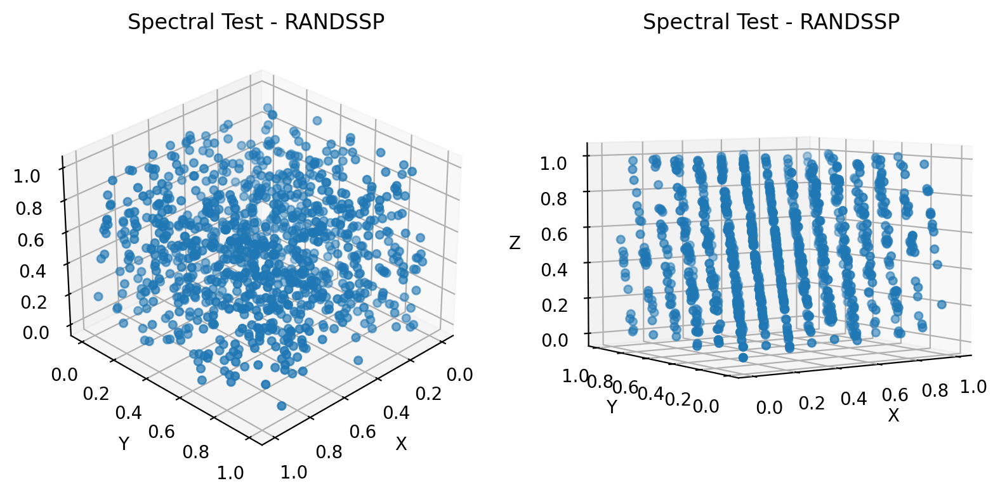

In [ ]:
def randssp(p, q):
    """
    PHYS20762 Computational Physics 2022-23 2nd Semester - University of Manchester

    RANDSSP Multiplicative congruential uniform random number generator.

    Generates an m-by-n random matrix based on the parameters used by IBM's
    Scientific Subroutine Package. This function uses the "bad" generator
    parameters that IBM used in several libraries in the 1960s. There is a
    strong serial correlation between three consecutive values. This generator
    is not recommended for modern applications requiring high-quality random numbers.

    Parameters:
    -----------
    p : int
        The number of rows in the generated random matrix.
    q : int
        The number of columns in the generated random matrix. If not provided, q is set to p.

    Returns:
    --------
    r : numpy.ndarray
        An array of shape (p, q) containing the randomly generated numbers.
    """

    global m, a, c, x

    try:
        x
    except NameError:
        m = pow(2, 31)
        a = pow(2, 16) + 3
        c = 0
        x = 123456789
    try:
        p
    except NameError:
        p = 1
    try:
        q
    except NameError:
        q = p
    r = np.zeros([p, q])

    for l in range(0, q):
        for k in range(0, p):
            x = np.mod(a * x + c, m)
            r[k, l] = x / m
    return r


# Generate the random points and plot them
random_points_randssp = randssp(3, 1000)

fig = plt.figure(figsize=plt.figaspect(0.5), dpi=200)  # Set the DPI of the figure

ax = fig.add_subplot(121, projection="3d")
ax.scatter(
    random_points_randssp[0, :],
    random_points_randssp[1, :],
    random_points_randssp[2, :],
)
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.set_title("Spectral Test - RANDSSP")
ax.view_init(elev=30, azim=45)  # Set the angles for the 3D figure

ax = fig.add_subplot(122, projection="3d")
ax.scatter(
    random_points_randssp[0, :],
    random_points_randssp[1, :],
    random_points_randssp[2, :],
)
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.set_title("Spectral Test - RANDSSP")
ax.view_init(elev=5, azim=235.5)  # Set the angles for the 3D figure


Albeit the distribution looks quite uniform from the general angle, the inspection from another angle reveals that the points very obviously lay on parallel hyperplanes. The presence of hyperplanes in the distribution of random numbers can introduce significant biases in Monte Carlo simulations, as the generated random numbers do not truly represent a uniform distribution.

## Producing Samples According to the Exponential Distribution

We turn to producing distributions informed by physics. The Beer-Lambert law is a fundamental principle in describing the attenuation of light (or any electromagnetic radiation) as it passes through a material. It can also be applied to describe the attenuation of thermal neutrons as they traverse a material. In this context, it states that the probability density function (PDF) for finding a thermal neutron at a depth $x$ within the material is given by: $$P(x)={\exp(-x/\lambda)},$$ where $\lambda$ represents the mean free path, the average distance a thermal neutron travels before being scattered or absorbed.

To generate random variables following a specific PDF, we can use the inverse distribution sampling method. This technique involves generating uniformly distributed random variables and then transforming them using the inverse of the cumulative distribution function (CDF) of the desired distribution. For the exponential distribution described by the Beer-Lambert law in the context of thermal neutron scattering, the CDF is given by: $$F(x)=1-\exp(-x/\lambda).$$

To apply inverse distribution sampling, we first generate a uniformly distributed random variable $u$ in the range $[0, 1]$. Then, we calculate the inverse of the CDF: $$x_i=F^{-1}(u_i)=-\lambda\ln(1-u_i).$$

However, as $u_i$ is uniformly distributed on the interval $[0, 1]$, it follows that $1 - u_i$ is also uniformly distributed within the same interval. We can, therefore, simplify the expression by substituting $1 - u_i$ with $u_i$: $$x_i=-\lambda\ln(u_i).$$ Here, $\lambda$ denotes the nominal mean free path. By transforming uniformly distributed random variables using this equation, we can generate samples following the exponential distribution described by the Beer-Lambert law.

With the desired distribution function, we can now generate random numbers following the exponential distribution. We will use the function using `numpy.random.uniform()` function to generate uniformly distributed random variables and then transform them using the inverse of the exponential CDF. The resulting random numbers should follow the exponential distribution which describes the Beer-Lambert law.


In [ ]:
def get_exponential_distribution(nominal_free_path, num_points, num_dimensions = 1):
    """
    Generates an array of points following an exponential distribution using the inverse
    distribution sampling method. The exponential distribution is based on the Beer-Lambert
    law for describing the attenuation of thermal neutrons in a material.
    Parameters:
    -----------
    nominal_free_path : float
        The nominal mean free path, representing the average distance a thermal neutron
        travels before being scattered or absorbed.
    num_points : int, optional, default: 1000
        The number of points to generate.
    num_dimensions : int, optional, default: 1
        The number of dimensions in which to generate the points.

    Returns:
    --------
    numpy.ndarray
        An array of shape (num_points, num_dimensions) containing the points following
        the exponential distribution based on the Beer-Lambert law.
    """
    return - nominal_free_path * np.log(get_uniform_distribution(num_points, num_dimensions))


Let's see the behaviour of the generator:

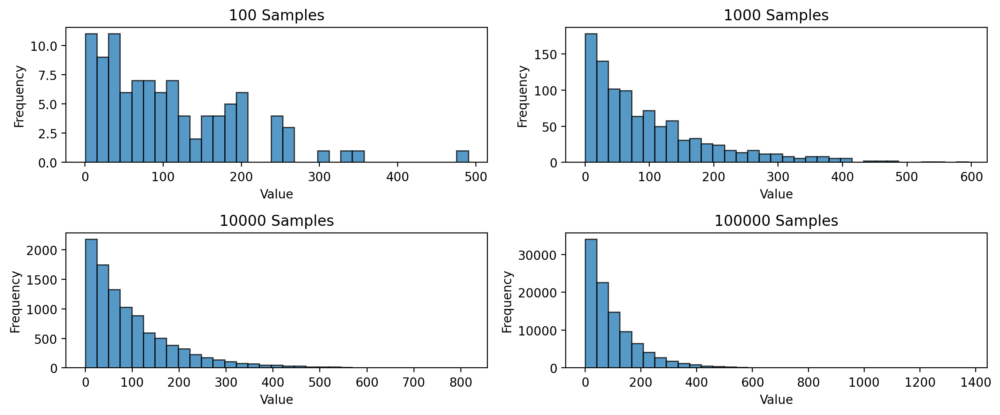

In [ ]:
# Define the number of samples, bins, and nominal free path
samples = [100, 1000, 10000, 100000]
bins = 33
nominal_free_path = 100

# Create a figure with four subplots
fig, axes = plt.subplots(2, 2, figsize=plt.figaspect(0.42), dpi=200)

# Loop over the subplots and generate random samples
for i, ax in enumerate(axes.flat):
    # Generate random samples using get_exponential_distribution()
    data = get_exponential_distribution(nominal_free_path, samples[i])

    # Create a histogram with the specified number of bins
    ax.hist(data, bins=bins, edgecolor='black', alpha=0.75)

    # Set the title and labels for the subplot
    ax.set_title(f'{samples[i]} Samples')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Set the layout of the figure and display it
plt.tight_layout()
plt.show()

Similar as in the demonstration with the uniform distribution, with the number of samples increasing, the distribution shows a better approximation of the desired exponential distribution.

## Characteristic Attenuation of Water (without Scattering)

Now, we want to demonstrate that the characteristic attenuation length in water is about 45cm, using the thermal neutron data implemented above, and assuming  **no scattering**. Each neutron is absorbed after a single step with a probability of unity. The distance at which each neutron gets absorbed is sampled exponentially with the water absorption nominal free path.

After creating a histogram with `get_exponential_distribution` with $R$ bins, we expect the frequency (height) of the $i$-th bin to be $$N_r\exp{(-R_i/\lambda_a)},$$ where $R_i$ represents the distance at which $N_r$ neutrons are absorbed, and $\lambda_a$ corresponds to the absorption mean free path.

When we plot the logarithm of the frequency $\log(N_R)$ against the distance, a straight line should appear with a slope of $k=-1/\hat{\lambda}$, where $\hat{\lambda}$ represents the estimated mean free path.

This is done using `np.polyfit`. In this case, the error on the slope can be calculated using the returned covariance matrix $C$ from. As $\sigma_k=\sqrt{C_{11}}$, the error on $\hat{\lambda}$ is $$\sigma_{\hat{\lambda}}=\frac{\hat{\lambda}\sqrt{C_{11}}}{k}.$$

Additionally, care must be taken to avoid taking the logarithm of the frequency for bins with zero counts.

Due to the fact the number of simulations must be large (due to the same reasons as above), optimally, we want to use the weights parameter in `np.polyfit` - the larger the error, the smaller the weight in the fit. We will rerun the experiment `N_EXPERIMENTS` times, and then average the results. The standard deviation is obtained from the variation of every single bin rather than the $\sqrt{N}$ error as in the uniform distribution experiment above. Both the histogram and the logarithm plot include error bars.

As a reminder, the mean free path $\lambda$ for a process is calculated as $\lambda=\frac{1}{n\sigma}$.

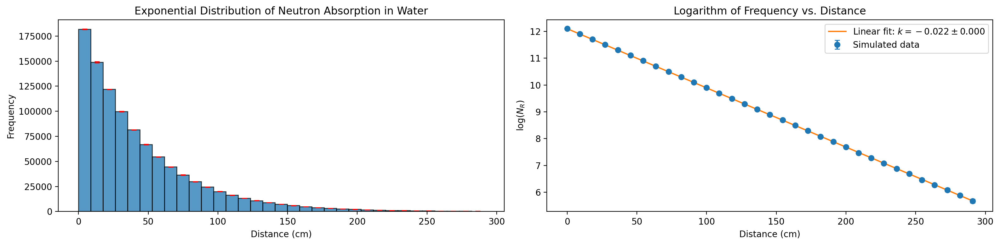

The expected nominal mean free path from the given number density and absorption cross section is 45.19 cm.
Attenuation length from the linear fit is 45.28 cm ± 0.06 cm


In [ ]:
# Constants
N_EXPERIMENTS = 10  # Number of experiments to run
NUM_POINTS = 1000000  # Number of points to generate
CUTOFF_DISTANCE = 300  # Cutoff distance in cm, after which the neutrons are taken into account for the fit
BINS = 33  # Number of bins for the histogram

nominal_mean_free_path = WATER.absorption_nominal_free_path

# Generate an array of points following the exponential distribution
generated_points = get_exponential_distribution(nominal_mean_free_path, NUM_POINTS)

# Apply the cutoff distance
generated_points = generated_points[generated_points <= CUTOFF_DISTANCE]

# Create a histogram
counts, edges = np.histogram(generated_points, bins=BINS)

# Run the experiment N_EXPERIMENTS times and calculate the standard deviation for each bin
bin_counts = np.empty((N_EXPERIMENTS, len(counts)))

for i in range(N_EXPERIMENTS):
    points = get_exponential_distribution(nominal_mean_free_path, NUM_POINTS)
    points = points[points <= CUTOFF_DISTANCE]
    exp_counts, _ = np.histogram(points, bins=edges)
    bin_counts[i] = exp_counts
std_devs = np.std(bin_counts, axis=0)

# Calculate the average bin counts from all the experiments
avg_bin_counts = np.mean(bin_counts, axis=0)

# Remove zero counts to avoid taking the logarithm of zero
non_zero_counts = avg_bin_counts > 0
avg_bin_counts_no_zero = avg_bin_counts[non_zero_counts]
edges_no_zero = edges[:-1][non_zero_counts]
std_devs_no_zero = std_devs[non_zero_counts]

# Perform the weighted linear fit using numpy.polyfit
weights = std_devs_no_zero
coeffs, cov_matrix = np.polyfit(
    edges_no_zero, np.log(avg_bin_counts_no_zero), 1, w=1 / weights, cov=True
)
k, ln_A = coeffs
k_error = np.sqrt(cov_matrix[0, 0])

# Calculate the attenuation length and its uncertainty
attenuation_length = -1 / k
attenuation_length_error = np.abs((attenuation_length * k_error) / k)

# Create a figure with two subplots side by side
fig, axes = plt.subplots(1, 2, figsize=plt.figaspect(0.25), dpi=200)

# Plot the exponential distribution with standard deviation error bars
n, bins, patches = axes[0].hist(
    edges[:-1], bins=BINS, weights=avg_bin_counts, edgecolor="black", alpha=0.75
)
bin_centers = 0.5 * (bins[:-1] + bins[1:])
axes[0].errorbar(
    bin_centers, avg_bin_counts, yerr=std_devs, fmt="none", color="r", capsize=3
)
axes[0].set_title("Exponential Distribution of Neutron Absorption in Water")
axes[0].set_xlabel("Distance (cm)")
axes[0].set_ylabel("Frequency")

# Plot the logarithm of the frequency with the linear polyfit
axes[1].errorbar(
    edges_no_zero,
    np.log(avg_bin_counts_no_zero),
    yerr=std_devs_no_zero / avg_bin_counts_no_zero,
    fmt="o",
    capsize=3,
    label="Simulated data",
)
axes[1].plot(
    edges_no_zero,
    k * edges_no_zero + ln_A,
    label=f"Linear fit: $k={k:.3f} \pm {k_error:.3f}$",
)
axes[1].set_title("Logarithm of Frequency vs. Distance")
axes[1].set_xlabel("Distance (cm)")
axes[1].set_ylabel("$\log(N_R)$")
axes[1].legend()

# Set the layout of the figure and display it
plt.tight_layout()
plt.show()

print(
    f"The expected nominal mean free path from the given number density and absorption cross section is {nominal_mean_free_path:.2f} cm."
)

print(
    f"Attenuation length from the linear fit is {attenuation_length:.2f} cm ± {attenuation_length_error:.2f} cm"
)


Upon repeating the experiment many times, we observe that the result is not always be exactly the same as the expected value from the given number density and absorption cross section. However, it will be close to it. Increasing `N_EXPERIMENTS` and `N_SAMPLES` improves the accuracy, but there will always be some statistical jitter due to the nature of our Monte Carlo simulation.

Additionally, the right endpoints of the fitted graph will be dominated by statistical fluctuations, which will influence the fit accuracy, which is the reason why we used `CUTOFF_DISTANCE`. Such points generally have larger uncertainties due to the division by the small bin count (which isn't visually prominent with the hyperparameter combination left in the notebook!) from being taken into account less often throughout the simulation - hence our weighting in the `polyfit` is useful.

This gives us the opportunity to look at the result of the obtained attenuation length for a different number of experiments. Let's inspect what happens when we vary the number the number of samples for a given `N_EXPERIMENTS`, looking at the variation of the obtained attenuation length and the error from expected nominal free path. The abscissas are in log scale.

In the right plot, we show that the reciprocal squared error from the nominal path, $\delta\hat{\lambda}^{-2}$, can be fitted well linearly to the size of the sample.

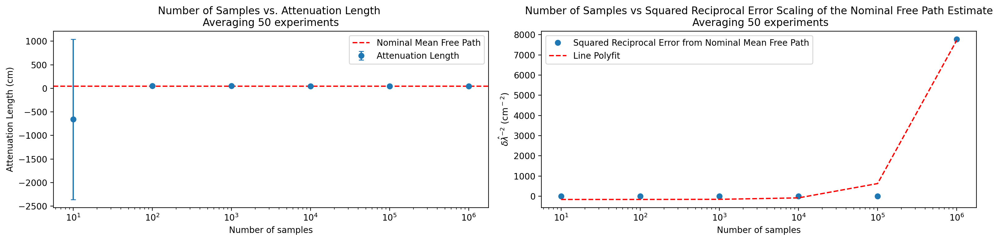

In [ ]:
# Constants
N_EXPERIMENTS = 50  # Number of experiments to run
CUTOFF_DISTANCE = 300  # Cutoff distance in cm, after which the neutrons are not binned
BINS = 33  # Number of bins for the histogram
NUM_POINTS_LIST = [10, 100, 1000, 10000, 100000, 1000000]

nominal_mean_free_path = WATER.absorption_nominal_free_path

attenuation_lengths = []
attenuation_length_errors = []

for NUM_POINTS in NUM_POINTS_LIST:
    # Run the experiment N_EXPERIMENTS times and calculate the standard deviation for each bin
    bin_counts = np.empty((N_EXPERIMENTS, BINS))

    for i in range(N_EXPERIMENTS):
        points = get_exponential_distribution(nominal_mean_free_path, NUM_POINTS)
        points = points[points <= CUTOFF_DISTANCE]
        exp_counts, edges = np.histogram(points, bins=BINS)
        bin_counts[i] = exp_counts
    std_devs = np.std(bin_counts, axis=0)

    # Calculate the average bin counts from all the experiments
    avg_bin_counts = np.mean(bin_counts, axis=0)

    # Remove zero counts to avoid taking the logarithm of zero
    non_zero_counts = avg_bin_counts > 0
    avg_bin_counts_no_zero = avg_bin_counts[non_zero_counts]
    edges_no_zero = edges[:-1][non_zero_counts]
    std_devs_no_zero = std_devs[non_zero_counts]

    # Perform the weighted linear fit using numpy.polyfit
    weights = std_devs_no_zero
    coeffs, cov_matrix = np.polyfit(
        edges_no_zero, np.log(avg_bin_counts_no_zero), 1, w=1 / weights, cov=True
    )
    k, ln_A = coeffs
    k_error = np.sqrt(cov_matrix[0, 0])

    # Calculate the attenuation length and its uncertainty
    attenuation_length = -1 / k
    attenuation_length_error = np.abs((attenuation_length * k_error) / k)

    attenuation_lengths.append(attenuation_length)
    attenuation_length_errors.append(attenuation_length_error)
# Create a figure with two subplots side by side
fig, axes = plt.subplots(1, 2, figsize=plt.figaspect(0.25), dpi=200)

# Plot NUM_POINTS against the obtained attenuation length with corresponding error
axes[0].errorbar(
    NUM_POINTS_LIST,
    attenuation_lengths,
    yerr=attenuation_length_errors,
    fmt="o",
    capsize=3,
    label="Attenuation Length",
)
axes[0].axhline(
    y=nominal_mean_free_path,
    linestyle="--",
    color="r",
    label="Nominal Mean Free Path",
)
axes[0].set_xscale("log")
axes[0].set_title(
    f"Number of Samples vs. Attenuation Length \nAveraging {N_EXPERIMENTS} experiments"
)
axes[0].set_xlabel(f"Number of samples")
axes[0].set_ylabel("Attenuation Length (cm)")
axes[0].legend()

# Plot NUM_POINTS against the rec. sq. error the obtained attenuation length from the nominal_mean_free_path
errors_from_nominal_rec_squared = (np.array(attenuation_lengths) - nominal_mean_free_path) ** (-2)
axes[1].plot(
    NUM_POINTS_LIST,
    errors_from_nominal_rec_squared,
    "o",
    label="Squared Reciprocal Error from Nominal Mean Free Path",
)
# show that error quantity scales with a line fit
axes[1].plot(
    NUM_POINTS_LIST,
    np.polyval(
        np.polyfit(NUM_POINTS_LIST, np.abs(errors_from_nominal_rec_squared), deg=1, cov=False),
        NUM_POINTS_LIST,
    ),
    linestyle="--",
    label="Line Polyfit",
    color="r",
)
axes[1].set_xscale("log")
axes[1].set_title(
    f"Number of Samples vs Squared Reciprocal Error Scaling of the Nominal Free Path Estimate\n Averaging {N_EXPERIMENTS} experiments"
)
axes[1].set_xlabel("Number of samples")
axes[1].set_ylabel(r"$\delta\hat{\lambda}^{-2}$ (cm$^-$$^2$)")
axes[1].legend()

# Set the layout of the figure and display it
plt.tight_layout()
plt.show()


As expected, usually, the smaller number of samples results in a larger standard deviation, and usually, the error from the nominal value will be larger for a smaller number of samples.

Adding to the point that the right hand side points will have much larger statistical fluctuations: we can additionally conclude that the the estimate of $\hat{\lambda}$ will *usually* be an overestimate given that the number of samples is small. This is because at the higher values of distance, quantization of the frequency becomes important, and the number of samples is not large enough to compensate for this, thus the frequency has a larger standard deviation - which makes the line flatter, thus $\hat{\lambda}$ is larger. These effects can be seen when the number of samples is small.

Additionally, in the right plot, a dashed line is included, which shows that the error goes approximately as $\frac{1}{\sqrt{N}}$, where N is the number of samples.

## Generating Isotropic Unit Vectors

We continue building our thermal neutron simulation. Considering scattering requires deciding whether the scattering will isotropic or not. In this notebook, we only consider isotropic scattering, that is, the properties of the scattering process are independent of the direction of the neutron. This is a decent approximation for thermal neutrons (the wavelength is larger than the size of the scattering nuclei). As a reminder, $\lambda$ will become $$\lambda=\frac{1}{n(\sigma_s+\sigma_a)}.$$

 First, we build isotropic unit vectors $\vec{r}=x\vec{i}+y\vec{j}+z\vec{k}$, so that $|\vec{r}|=x^2+y^2+z^2=1$. This is convenient to do in spherical polars and then doing a trigonometric conversion. It may seem that we would be able to achieve this by satisfing the $|\vec{r}|=1$ condition and then using the fact that the probability density function is uniform in $[0,\pi]$ for the polar angle and $[0,2\pi]$ for the azimuthal angle.

 **However, this is not the case**, as the probability density function is uniform in the solid angle, which is not the same as the probability density function being uniform in the spherical polars. Additionally, density of the points would increase going further away from the centre of the sphere, as cross section decreases as one moves away from the centre. Carrying out the procedure in this manner would result in a higher concentration of points near the poles, which is non-isotropic behaviour.

 This can be countered by using the fact that the probability density function is uniform in the solid angle, which is given by $$\frac{d\Omega}{d\cos{\theta}}=2\pi\sin{\theta}.$$ This can be used to generate the polar angle $\theta$ by using the inverse of the cumulative distribution function of the probability density function, which is $$\cos{\theta}=1-2u,$$ where $u$ is a uniformly distributed random variable in $[0,1]$. Then, the polar angle $\theta$ can be generated by using the fact that the probability density function is uniform in the solid angle. Therefore, we have $$\theta=\arccos{(1-2u)}.$$

  The azimuthal angle $\phi$ can be generated by using the fact that the probability density function is uniform in $[0,2\pi]$, which is given by $$\phi=2\pi v,$$ where $v$ is a uniformly distributed random variable in $[0,1]$.

  This is implemented in `get_isotropic_unit_vector`.

In [ ]:
def get_isotropic_vectors(number_of_vectors):
    """
    Returns an array of random unit vectors with isotropic distributions.

    This function generates a specified number of random isotropic unit vectors by
    first generating the polar angle and azimuthal angle from
    uniformly distributed random variables and then converting
    them to Cartesian coordinates.

    Args:
        number_of_vectors (int): The number of isotropic unit vectors to generate.

    Returns:
        numpy.ndarray: An array of random isotropic unit vectors.
    """
    vectors = np.empty((number_of_vectors, 3))

    for i in range(number_of_vectors):
        # Get two random numbers between 0 and 1
        u1 = np.random.rand()
        u2 = np.random.rand()

        # Calculate the azimuthal angle
        phi = 2 * np.pi * u1

        # Calculate the polar angle
        theta = np.arccos(2 * u2 - 1)

        # Calculate the cartesian coordinates
        x = np.sin(theta) * np.cos(phi)
        y = np.sin(theta) * np.sin(phi)
        z = np.cos(theta)

        vectors[i] = np.array([x, y, z])

    return vectors


Let's test the uniformity by generating a large number of isotropic unit vectors and plotting them on a sphere:

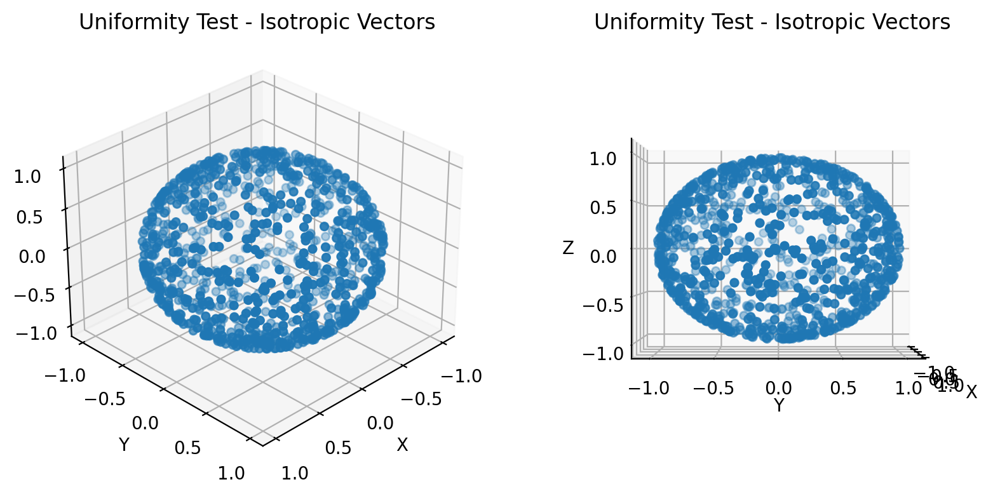

In [ ]:
# Generate the random points
random_points = get_isotropic_vectors(1000)

# Plot the points
fig = plt.figure(figsize=plt.figaspect(0.5), dpi=200)  # Set the DPI of the figure

# Plot the points in two different angles
ax = fig.add_subplot(121, projection="3d")
ax.scatter(
    random_points[:, 0],
    random_points[:, 1],
    random_points[:, 2],
)
# Set the labels and title for the subplot
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.set_title("Uniformity Test - Isotropic Vectors")
ax.view_init(elev=30, azim=45)  # Set the angles for the 3D figure

# Plot the points in two different angles
ax = fig.add_subplot(122, projection="3d")
ax.scatter(
    random_points[:, 0],
    random_points[:, 1],
    random_points[:, 2],
)
# Set the labels and title for the subplot
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.set_title("Uniformity Test - Isotropic Vectors")
ax.view_init(elev=0, azim=0)  # Set the angles for the 3D figure

plt.show()


 We can see that the points are uniformly distributed on the sphere, as expected, and there are no poles.

## Generating Isotropic Steps in the Exponential Distribution

Now, it will be relatively straighforward to generate isotropic steps with lengths distributed as $\exp(-x/\lambda)$. This is achieved by simply scaling the return of `get_isotropic_vectors` with `get_exponential_distribution`.

In [ ]:
def get_isotropic_exponential_steps(mean_path, num_points):
    """
    Generates a num_points length array of three (x, y, z) arrays of isotropic steps with lengths distributed as exp(-x/lambda).

    This function combines the generation of isotropic unit vectors and the exponential
    distribution of step lengths to create isotropic steps with lengths distributed
    as exp(-x/lambda).

    Args:
        mean_path (float): The mean path, representing the average distance
                                   a thermal neutron travels before being scattered or absorbed.
        num_points (int): The number of isotropic steps to generate.

    Returns:
        numpy.ndarray: An array of shape (num_points, 3), representing the x, y, and z components
                       of the isotropic steps with lengths distributed as exp(-x/lambda).
    """
    # Generate isotropic unit vectors
    unit_vectors = get_isotropic_vectors(num_points)

    # Generate exponential step lengths
    step_lengths = get_exponential_distribution(mean_path, num_points)

    # Scale unit vectors by step lengths
    isotropic_steps = np.array(
        [
            unit_vectors[index] * step_lengths[index]
            for index in range(len(unit_vectors))
        ]
    )

    return isotropic_steps

Now, we can generate the steps and visualize them, not taking into account absorption or scattering. All the steps are inside each of the materials.

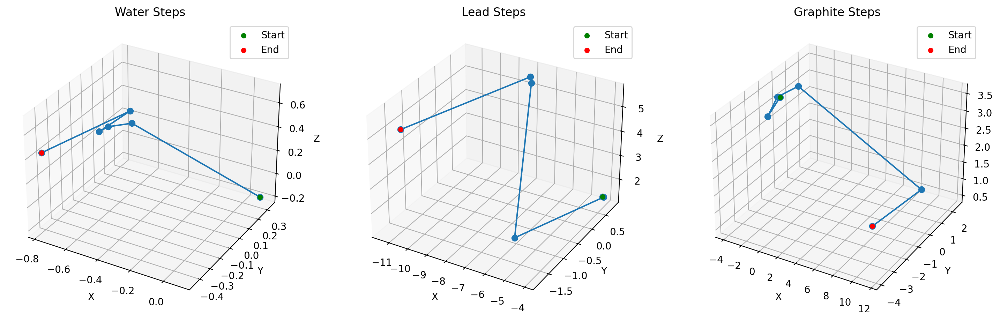

In [ ]:
# Generate isotropic exponential steps for each material
num_steps = 6
steps_water = get_isotropic_exponential_steps(WATER.mean_path, num_steps)
steps_lead = get_isotropic_exponential_steps(LEAD.mean_path, num_steps)
steps_graphite = get_isotropic_exponential_steps(GRAPHITE.mean_path, num_steps)

# Set up the figure and axes for 3D plotting
fig = plt.figure(figsize=(18, 6), dpi=200)

ax_water = fig.add_subplot(131, projection="3d")
ax_lead = fig.add_subplot(132, projection="3d")
ax_graphite = fig.add_subplot(133, projection="3d")

# Plot the steps for each material
def plot_steps(ax, steps, material_name):
    x, y, z = np.cumsum(steps[:, 0]), np.cumsum(steps[:, 1]), np.cumsum(steps[:, 2])
    ax.plot(x, y, z, marker="o")
    ax.scatter(x[0], y[0], z[0], c="green", label="Start")
    ax.scatter(x[-1], y[-1], z[-1], c="red", label="End")
    ax.set_title(f"{material_name} Steps")
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.legend()

plot_steps(ax_water, steps_water, "Water")
plot_steps(ax_lead, steps_lead, "Lead")
plot_steps(ax_graphite, steps_graphite, "Graphite")

plt.show()


## Simulating the Behaviour of Thermal Neutrons

We proceed to simulating the behaviour of thermal neutrons. As a reminder, the `Material` class already has properties `total_section`, `mean_path`, `absorption_probability`, and `scattering_probability`, which will be useful in here. For example, it's a useful sanity check to see that the sum of absorption probability and scattering probability is indeed unity for all materials (except vacuum, in which the neutron is neither absorbed nor scattered):

In [ ]:
for material in [WATER, LEAD, GRAPHITE, VACUUM]:
    print(str(material) + f" mean_path: {material.mean_path:.2f} cm")
    print(str(material) + f" absorption_probability: {material.absorption_probability:.4f}")
    print(str(material) + f" scattering_probability: {material.scattering_probability:.4f}\n")

Water mean_path: 0.29 cm
Water absorption_probability: 0.0064
Water scattering_probability: 0.9936

Lead mean_path: 2.67 cm
Lead absorption_probability: 0.0139
Lead scattering_probability: 0.9861

Graphite mean_path: 2.52 cm
Graphite absorption_probability: 0.0009
Graphite scattering_probability: 0.9991

Vacuum mean_path: inf cm
Vacuum absorption_probability: 0.0000
Vacuum scattering_probability: 0.0000



Now, we can consider a neutron entering the slab at $x=0$, where the slab is in $x\in [0:L]$, $L$ being the thickness, while $y\in (-\infty:+\infty)$ and  $z\in (-\infty:+\infty)$ for the slab. We can perform a random walk according to the distribution $\exp(-x/\lambda)$. For each step, we check whether the neutron is absorbed, scattered within the slab, or escaped from it ($x<0$ or $x>L$). The random walk only continues if the neutron is found to be scattered inside the slab. The first step is generated at  $\vec{r}=(0, 0, 0)$.

For later, we can note that if we did not want to visualize the neutron behaviour, we could have completely ignored the $y$ and $z$ dimensions.

The physical condition that the first step must be positive in the $x_+$ direction requires us to modify the `get_isotropic_vectors` function to satisfy this it - the first generated vector must be $i + 0j + 0k$.

In [ ]:
def get_isotropic_vectors_with_x0_positive(number_of_vectors):
    """
    Returns an array of random unit vectors with isotropic distributions.

    This function generates a specified number of random isotropic unit vectors by
    first generating the polar angle and azimuthal angle from
    uniformly distributed random variables and then converting
    them to Cartesian coordinates.
    This is different to the get_isotropic_vectors function in that
    the first vector is always [1, 0, 0].

    Args:
        number_of_vectors (int): The number of isotropic unit vectors to generate.

    Returns:
        numpy.ndarray: An array of random isotropic unit vectors.
    """
    vectors = np.empty((number_of_vectors, 3))

    # Set the first vector to [1, 0, 0]
    vectors[0] = np.array([1, 0, 0])

    if number_of_vectors > 1:
        for i in range(1, number_of_vectors):
            # Get two random numbers between 0 and 1
            u1 = np.random.rand()
            u2 = np.random.rand()

            # Calculate the azimuthal angle
            phi = 2 * np.pi * u1

            # Calculate the polar angle
            theta = np.arccos(2 * u2 - 1)

            # Calculate the cartesian coordinates
            x = np.sin(theta) * np.cos(phi)
            y = np.sin(theta) * np.sin(phi)
            z = np.cos(theta)

            vectors[i] = np.array([x, y, z])

    return vectors

def get_isotropic_exponential_steps_with_x0_positive(mean_path, num_points):
    """
    Generates a num_points length array of three (x, y, z) arrays of isotropic steps with lengths distributed as exp(-x/lambda).

    This function combines the generation of isotropic unit vectors and the exponential
    distribution of step lengths to create isotropic steps with lengths distributed
    as exp(-x/lambda). This is different to the get_isotropic_exponential_steps
    function in that the first vector has a positive x0 component.

    Args:
        mean_path (float): The mean path, representing the average distance
                                   a thermal neutron travels before being scattered or absorbed.
        num_points (int): The number of isotropic steps to generate.

    Returns:
        numpy.ndarray: An array of shape (num_points, 3), representing the x, y, and z components
                       of the isotropic steps with lengths distributed as exp(-x/lambda).
    """
    # Generate isotropic unit vectors
    unit_vectors = get_isotropic_vectors_with_x0_positive(num_points)

    # Generate exponential step lengths
    step_lengths = get_exponential_distribution(mean_path, num_points)

    # Scale unit vectors by step lengths
    isotropic_steps = np.array(
        [
            unit_vectors[index] * step_lengths[index]
            for index in range(len(unit_vectors))
        ]
    )

    return isotropic_steps


## Visualising the Behaviour of a Neutron in the Slab

The `single_neutron_1d_mc_with_position_history` function simulates the movement of a single neutron through a slab of material and tracks its position history, taking into account the possible outcomes of absorption, transmission, or reflection in order to visualise the behaviour - it's slower than our following implementation aimed at statistics, but still uses Numpy's slicing while retaining history, making it much faster than just a `while(Alive)` for each neutron. The function follows these steps:

1. Set the neutron's initial position at $r=0$ (the first element of its positions array). Generate the index of the step at which the neutron would be absorbed, assuming the slab is infinite in all directions. This will later be compared to the index of the step at which the neutron escaped the slab.
2. If the neutron was absorbed during the first step, simulate a single step to determine the absorption point (for plotting purposes).
3. If the neutron was absorbed later, simulate its positions up to the step it was absorbed, which is the maximum number of steps it can take.
4. Check the simulated positions and find the index of the step where the neutron was transmitted or reflected from the slab (if it happened).
5. Return the event type and the history of the positions - if the neutron got absorbed, the position index where it got absorbed, if the neutron got transmitted or reflected, the position index where it got out of the slab. Additionally, return the index of the step where it got absorbed.

In [ ]:
def single_neutron_1d_mc_with_position_history(material, thickness):
    """
    Simulates the motion of a single neutron through a material slab and tracks its position history.
    The first element of the motion array is the origin.

    If the neutron got reflected or transmitted outside the slab, movement history is returned
    up to the first point where it is outside the slab.
    If the neutron got absorbed, movement history is returned up to the point where it got absorbed.

    Parameters:
    material (Material): The material through which the neutron travels.
    thickness (float): The thickness of the material slab.

    Returns:
    outcome (str): The outcome of the simulation, either "Absorbed", "Transmitted", or "Reflected".
    particle_position_history (numpy.ndarray): The position history of the neutron in 3D coordinates.
    terminating_index (int): The index at which the neutron's motion was terminated due to absorption or escaping the slab.
    """

    # the index where the particle is hypothetically absorbed if it never escaped
    absorbed_index = 1 + next(
        i
        for i, point in enumerate(iter(lambda: np.random.uniform(0, 1), 1))
        if point < material.absorption_probability
    )
    # Sometimes the particle will get absorbed after the first step:
    if absorbed_index == 1:
        outcome = "Absorbed"
        # still want to calculate the position where it got absorbed for the plot
        steps_hypothetical = get_isotropic_exponential_steps_with_x0_positive(
            material.mean_path, 1
        )
        # calculate the hypothetical position history of the particle, make sure the first element is the origin
        particle_position_history = np.cumsum(
            np.vstack(([0, 0, 0], steps_hypothetical)), axis=0
        ).T
        terminating_index = 1
    else:
        # the array of steps is of maximum hypothetical length index_absorbed
        steps_hypothetical = get_isotropic_exponential_steps_with_x0_positive(
            material.mean_path, absorbed_index
        )

        # calculate the hypothetical position history of the particle, make sure the first element is the origin
        particle_position_history = np.cumsum(
            np.vstack(([0, 0, 0], steps_hypothetical)), axis=0
        ).T

        # first index where the particle hypothetically got out of the slab at X = thickness + some epsilon
        transmitted_index = next(
            (
                i
                for i, x_val in enumerate(particle_position_history[0])
                if x_val > thickness
            ),
            None,
        )

        # first index where the particle hypothetically got out of the slab at X = 0 - some epsilon
        reflected_index = next(
            (i for i, x_val in enumerate(particle_position_history[0]) if x_val < 0),
            None,
        )

        outcome_indices = {
            "Absorbed": absorbed_index,
            "Transmitted": transmitted_index,
            "Reflected": reflected_index,
        }

        # Find what outcome happened first
        outcome, terminating_index = min(
            outcome_indices.items(),
            key=lambda x: x[1] if x[1] is not None else float("inf"),
        )
    # If it got out of the slab, the last position for plotting is the first where it is outside the slab
    if outcome in ["Reflected", "Transmitted"]:
        particle_position_history = particle_position_history[
            :, : terminating_index + 1
        ]
    # if it got absorbed, the last position for plotting is the one where it got absorbed
    else:
        particle_position_history = particle_position_history[:, :terminating_index]
    return outcome, particle_position_history, terminating_index


Now, we can visualize the neutrons behaviour in the slab. We can see that the neutrons are absorbed in the slab, transmitted through it, or reflected from it. The neutrons starting points are shown in green. The endpoints for neutrons that are absorbed are shown in red, and the endpoints of neutrons that are either reflected or transmitted are shown in blue. Their path is traced in blue lines. Additionally, the script shows a brown plane at the entry position of the slab and, if it got transmitted, an orange plane at the exit position of the slab.

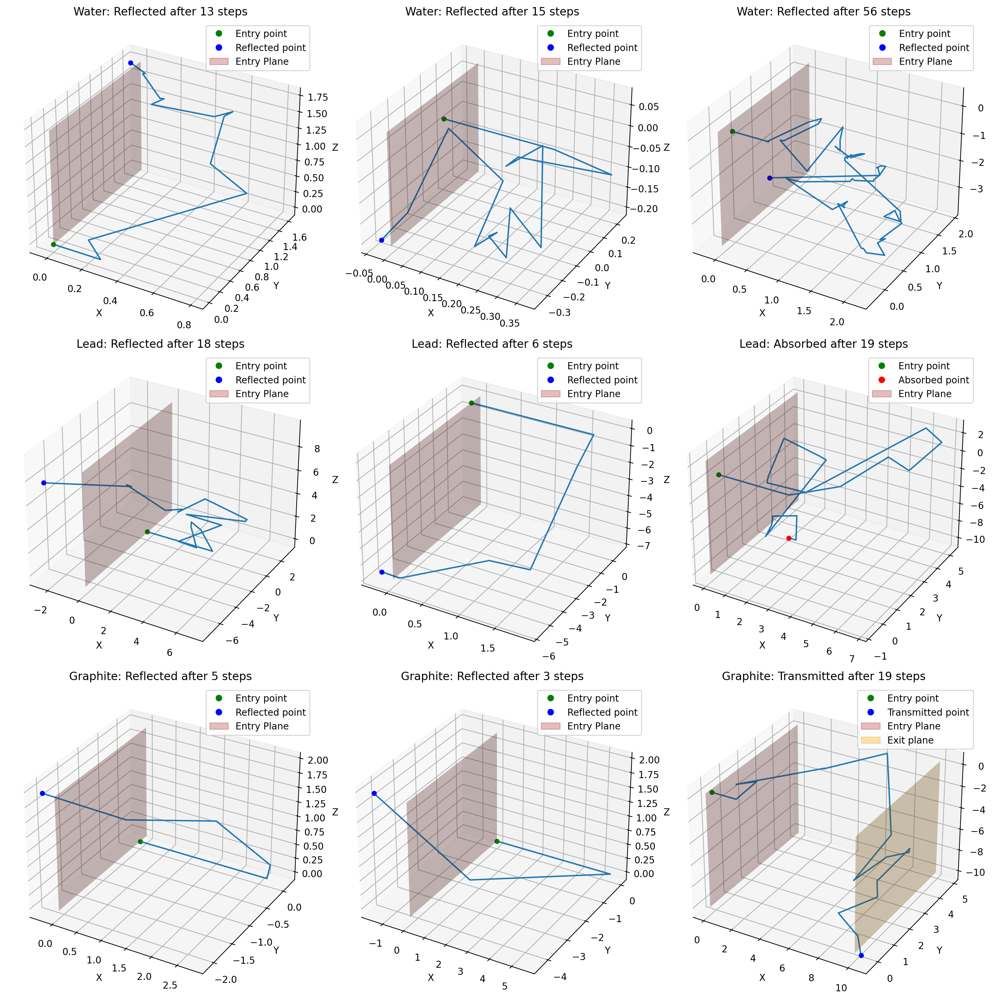

In [ ]:
THICKNESS = 10 # in cm
materials = [WATER, LEAD, GRAPHITE]

fig = plt.figure(figsize=(15, 15), dpi=200)

# iterate over the materials
for i, material in enumerate(materials):
    # iterate over the plots
    for j in range(3):
        # create a subplot for each material and each outcome
        ax = fig.add_subplot(3, 3, 3 * i + j + 1, projection="3d")
        (
            outcome,
            position_history,
            step_number,
        ) = single_neutron_1d_mc_with_position_history(material, THICKNESS)
        # plot the position history
        ax.plot(position_history[0], position_history[1], position_history[2])

        # set the labels and colors based on the outcome
        start_label = "Entry point"
        end_label = f"{outcome} point"
        start_color = "green"
        end_color = "red" if outcome == "Absorbed" else "blue"

        # plot the entry and exit points
        ax.scatter(
            position_history[0, 0],
            position_history[1, 0],
            position_history[2, 0],
            c=start_color,
            label=start_label,
        )
        ax.scatter(
            position_history[0, -1],
            position_history[1, -1],
            position_history[2, -1],
            c=end_color,
            label=end_label,
        )

        # Create the legend proxy artists
        green_point = Line2D(
            [0], [0], linestyle="none", marker="o", color="green", label=start_label
        )
        end_point = Line2D(
            [0], [0], linestyle="none", marker="o", color=end_color, label=end_label
        )
        legend_handles = [green_point, end_point]

        # set the title and labels
        ax.set_title(f"{material.name}: {outcome} after {step_number} steps")
        ax.set_xlabel("X")
        ax.set_ylabel("Y")
        ax.set_zlabel("Z")
        ax.legend()

        # Create a transparent plane parallel to the Y and Z axes at x=0
        yy_entry, zz_entry = np.meshgrid(
            np.linspace(
                np.min(position_history[1, :]), np.max(position_history[1, :]), 2
            ),
            np.linspace(
                np.min(position_history[2, :]), np.max(position_history[2, :]), 2
            ),
        )
        ax.plot_surface(0, yy_entry, zz_entry, alpha=0.3, color="brown")
        brown_patch = mpatches.Patch(color="brown", label="Entry Plane", alpha=0.3)
        legend_handles.append(brown_patch)
        # Create a transparent plane parallel to the Y and Z axes at x=THICKNESS if it got transmitted
        if outcome == "Transmitted":
            ax.plot_surface(THICKNESS, yy_entry, zz_entry, alpha=0.3, color="orange")
            orange_patch = mpatches.Patch(color="orange", label="Exit plane", alpha=0.3)
            legend_handles.append(orange_patch)

        ax.legend(handles=legend_handles)

plt.tight_layout()
plt.show()


## Statistical Observations

However, to answer statistical questions, we don't need to track the particles trajectory. We can simply generate the number of particles absorbed, scattered, and escaped. `n_neutrons_1d_mc_statistics` function is designed for calculating statistical outcomes of neutrons interacting with the material, prioritizing speed over tracking individual neutron positions. It follows these steps:

1. Initialize the positions of all neutrons entering the material.
2. Calculate the step lengths for the initial step in the positive x-direction, and update the positions based on these step lengths.
3. Iterate through the remaining neutrons, determining which neutrons are transmitted, absorbed, or reflected, and updating their positions accordingly with Numpy slicing and masks.
4. Generate new directions for the remaining neutrons and calculate the step magnitudes.
5. Update the positions of the remaining neutrons based on their step magnitudes and new directions.
6. Continue iterating until all neutrons have been either absorbed, transmitted, or reflected.
7. Return the number of neutrons absorbed, transmitted, and reflected.

In [ ]:
def n_neutrons_1d_mc_statistics(thickness, material, n_entering):
    """
    Simulate the behavior of neutrons in a 1D material of given thickness using Monte Carlo method.
    Only takes into account x position of the neutrons to speed up statistics calculation.

    Parameters
    ----------
    thickness : float
        The thickness of the material in the x-direction.
    material : Material
        The material object containing its properties (absorption_probability, mean_path).
    n_entering : int
        The number of neutrons entering the material.

    Returns
    -------
    num_absorbed : int
        The number of neutrons absorbed by the material.
    num_transmitted : int
        The number of neutrons transmitted through the material.
    num_reflected : int
        The number of neutrons reflected back from the material.
    """
    def update_positions(positions, step_lengths, directions):
        """Update the positions of neutrons based on step lengths and directions."""
        return positions + step_lengths * directions

    num_absorbed = num_transmitted = num_reflected = 0

    # Initialize the positions of neutrons
    particle_positions = np.zeros((n_entering, 1))

    # Calculate the step lengths for the initial step in the positive x-direction
    step_lengths = - material.mean_path * np.log(np.random.uniform(size=(particle_positions.shape[0], 1)))
    # Update positions based on initial step lengths
    particle_positions = update_positions(particle_positions, step_lengths, np.array([[1]]))

    # Iterate until all neutrons are either absorbed, transmitted, or reflected
    while particle_positions.shape[0] > 0:
        # Determine which neutrons are transmitted, absorbed, or reflected
        are_transmitted = particle_positions[:, 0] > thickness
        num_transmitted += np.count_nonzero(are_transmitted)

        are_absorbed = np.random.uniform(size=particle_positions.shape[0]) < material.absorption_probability
        num_absorbed += np.count_nonzero(are_absorbed)

        are_reflected = particle_positions[:, 0] < 0
        num_reflected += np.count_nonzero(are_reflected)

        # Update positions of remaining neutrons
        particle_positions = particle_positions[~(are_transmitted | are_absorbed | are_reflected)]

        # Generate new unit vectors for the remaining neutrons
        unit_vectors = np.random.randn(particle_positions.shape[0], 3)
        unit_vectors /= np.sqrt(np.einsum('...i,...i->...', unit_vectors, unit_vectors))[:, None]
        unit_vectors = unit_vectors[:, :1]

        # Calculate the step magnitudes for the remaining neutrons
        step_magnitudes = - material.mean_path * np.log(np.random.uniform(size=(particle_positions.shape[0], 1)))
        # Update positions based on step magnitudes and new directions
        particle_positions = update_positions(particle_positions, step_magnitudes, unit_vectors)

    return num_absorbed, num_transmitted, num_reflected


## Speed Comparison

Let's compare how many times faster one is than the other for `N_ENTERING` neutrons. Note that this is also an MC simulation - the sample size has to be decent, else it's likely that one method will get lucky with neutrons that get scattered much less. It will also depend on the material's properties too - the larger the probability of scattering, the larger the *expected mean* of the speedup ratio.

In [ ]:
N_ENTERING = 5000 # Number of neutrons entering the material
THICKNESS = 10 # in cm
MATERIAL = LEAD

# Run the simulation with position tracking
time_with_position = time.time()
for _ in range(N_ENTERING): single_neutron_1d_mc_with_position_history(WATER, THICKNESS)
time_with_position = time.time() - time_with_position

# Run the simulation without position tracking
time_no_position = time.time()
n_neutrons_1d_mc_statistics(THICKNESS, WATER, N_ENTERING)
time_no_position = time.time() - time_no_position

print(f"Time with position history: {time_with_position:.3f} s")
print(f"Time without position history: {time_no_position:.3f} s")
print(f"Function without position tracking is faster {time_with_position / time_no_position:.1f} times")

Time with position history: 14.406 s
Time without position history: 0.057 s
Function without position tracking is faster 252.8 times


We won't be determining the expected mean and standard deviation of the speedup, as it has nothing to do with physics, but a ball park figure is ~200 times. The main reasons for the speedup are:

1. **Vectorization.**  The second function takes advantage of the vectorization capabilities of NumPy, which leads to more efficient calculations. It processes multiple neutrons simultaneously instead of iterating through individual neutrons. NumPy functions are implemented in C and optimized for performance, so using them results in faster execution times compared to native Python loops.
2. **Dimensionality.**  The second function only considers the x position of the neutrons, essentially simulating a 1D problem. This simplification reduces the complexity of the calculations and accelerates the function's execution. The second function, on the other hand, simulates the motion of a neutron in 3D, requiring more complex calculations for each step.
3. **Position history tracking.**  The first function keeps track of the position history of the neutron, which adds to its computational overhead. The second function does not have this feature and only focuses on counting the number of absorbed, transmitted, and reflected neutrons, making it more efficient for obtaining statistics.
4. **Outcome determination.**  In the first function, determining the outcome of a neutron's movement (absorbed, transmitted, or reflected) involves iterating over different conditions and comparing indices, adding some overhead. In the first function, the outcomes are determined using simple NumPy comparisons and logical operations, which are more efficient.
5. **Calling Numpy directly.**  Additionally, the second function benefits from calling Numpy methods directly, while the first one uses the functions that we implemented previously (e.g. `get_isotropic_exponential_steps_with_x0_positive`). For a single iteration this would be neglibible, but when a function is called many times, as is the case in these simulations, these seemingly small overheads can accumulate and have a noticeable impact on performance.

## Determining Absorption, Transmission and Reflection Percentages

We are now able to speedily proceed to determining absorption, transmission, and reflection for each of the materials. We also need to take into account the arrising uncertainty. We can do this by running the simulation multiple times and calculating the mean and standard deviation of the number of particles absorbed, scattered, and escaped. For a single material, this is done `n_experiments` times in `perform_1d_static_thickness_simulations`.

In [ ]:
def perform_1d_constant_thickness_simulations(
    thickness, materials, n_experiments, n_entering, progress_bar=True
):
    """
    Performs 1D Monte Carlo simulations to determine the outcomes (absorbed, transmitted, reflected) of neutrons entering
    a material slab with a static thickness.

    Parameters:
    thickness (float): The thickness of the material slab in centimeters.
    materials (list): A list of Material objects representing the materials to simulate.
    n_experiments (int): The number of experiments to run for each material to determine the mean and standard deviation.
    n_entering (int): The number of neutrons entering the slab for each experiment.
    progress_bar (bool): Whether to display a progress bar for the experiments. Defaults to True.

    Returns:
    results (dict): A dictionary containing the results for each material, including the mean and standard deviation
                    of the absorbed, transmitted, and reflected neutrons.
    """
    results = {} # Initialize an empty dictionary to store the results for each material

    # Iterate over the materials
    for material in materials:
        # Initialize empty lists to store the results for each experiment
        absorption_results, transmission_results, reflection_results = [], [], []

        # Create a range object for the experiments
        experiment_range = range(n_experiments)

        # If progress_bar is True, wrap the range object with tqdm
        if progress_bar:
            experiment_range = tqdm(
                experiment_range,
                desc="Experiments with " + str(material),
                leave=True,
                position=0,
            )

        # Iterate over the experiments
        for _ in experiment_range:
            num_absorbed, num_transmitted, num_reflected = n_neutrons_1d_mc_statistics(thickness, material, n_entering)
            absorption_results.append(num_absorbed)
            transmission_results.append(num_transmitted)
            reflection_results.append(num_reflected)
            tqdm._instances.clear()

        # Calculate the mean and standard deviation for each outcome
        absorption_mean_std = (
            np.mean(absorption_results) / n_entering,
            np.std(absorption_results) / n_entering,
        )
        transmission_mean_std = (
            np.mean(transmission_results) / n_entering,
            np.std(transmission_results) / n_entering,
        )
        reflection_mean_std = (
            np.mean(reflection_results) / n_entering,
            np.std(reflection_results) / n_entering,
        )

        # Save the results in the dictionary
        results[f"{material}, {thickness} cm"] = {
            "Experiment": n_experiments,
            "Simulated": n_entering,
            "Absorbed": absorption_mean_std,
            "Transmitted": transmission_mean_std,
            "Reflected": reflection_mean_std,
        }
    return results


def print_formatted_results(results):
    """
    Prints the results of the Monte Carlo simulation for each material in a formatted and readable way, including
    the mean and standard deviation of absorbed, transmitted, and reflected neutrons as percentages.

    Parameters:
    results (dict): A dictionary containing the results for each material, including the mean and standard deviation
                    of the absorbed, transmitted, and reflected neutrons.

    Returns:
    None
    """
    print("Results Summary")
    print("===============")
    for material, data in results.items():
        print(f"Material: {material}")
        print(f"Experiments: {data['Experiment']}")
        print(f"Simulated Neutrons in each run: {data['Simulated']}")

        absorbed_mean, absorbed_std = data["Absorbed"]
        transmitted_mean, transmitted_std = data["Transmitted"]
        reflected_mean, reflected_std = data["Reflected"]

        print(f"  Absorbed: {absorbed_mean * 100:.2f}% (±{absorbed_std * 100:.2f}%)")
        print(
            f"  Transmitted: {transmitted_mean * 100:.2f}% (±{transmitted_std * 100:.2f}%)"
        )
        print(f"  Reflected: {reflected_mean * 100:.2f}% (±{reflected_std * 100:.2f}%)")
        print()


Thus, we calculate the absorption, transmission, and reflection percentages with `N_EXPERIMENTS` and `N_ENTERING` (note that each material takes less than a second):

In [ ]:
THICKNESS = 10  # in cm
MATERIALS = [WATER, LEAD, GRAPHITE]
N_EXPERIMENTS = 10  # to determine the std of the means for each material
N_ENTERING = 10000  # number of neutrons entering the slab for each experiment

results = perform_1d_constant_thickness_simulations(THICKNESS, MATERIALS, N_EXPERIMENTS, N_ENTERING, progress_bar=True)
print_formatted_results(results)

Experiments with Water:   0%|          | 0/10 [00:00<?, ?it/s]

Experiments with Lead:   0%|          | 0/10 [00:00<?, ?it/s]

Experiments with Graphite:   0%|          | 0/10 [00:00<?, ?it/s]

Results Summary
Material: Water, 10 cm
Experiments: 10
Simulated Neutrons in each run: 10000
  Absorbed: 20.41% (±0.36%)
  Transmitted: 0.32% (±0.05%)
  Reflected: 79.77% (±0.37%)

Material: Lead, 10 cm
Experiments: 10
Simulated Neutrons in each run: 10000
  Absorbed: 11.24% (±0.30%)
  Transmitted: 27.75% (±0.34%)
  Reflected: 62.25% (±0.34%)

Material: Graphite, 10 cm
Experiments: 10
Simulated Neutrons in each run: 10000
  Absorbed: 0.92% (±0.11%)
  Transmitted: 30.88% (±0.38%)
  Reflected: 68.31% (±0.32%)



Before delving deeper into the analysis of the results, we again note that this simulation is isotropic.

- **Absorption** We see that for the given thickness of all materials, not more than ~20% of the neutrons are absorbed - as predicted by the fact scattering scross sections of all materials are much higher than the absorption cross sections. Analogously, the *ratio* of absorption and scattering cross-sections is evident - graphite has the lowest ratio, and thus the absorption percentage is the lowest. On the other side of the spectrum, water has the highest ratio, and the highest absorbed percentage.

    The neutron cross sections can also be related to the physical properties of materials. It is reasonable to expect that water will have a higher absorption rate for thermal neutrons compared to graphite and lead. Hydrogen in water has a relatively high neutron scattering cross-section, which means it is more likely to interact with neutrons, slowing them down to thermal energies.

    Lead, despite having a high atomic number, has a lower absorption rate for thermal neutrons compared to water. Lead has a stable and filled nuclear energy level configuration, making it less likely to absorb neutrons. Lead has four naturally occurring isotopes: 204Pb, 206Pb, 207Pb, and 208Pb. The most abundant isotope, 208Pb (doubly magic), has a particularly low thermal neutron absorption cross-section.

    As for graphite, Carbon-12, the most abundant isotope of carbon, has a particularly low neutron capture cross-section. This is because of the nuclear structure of carbon-12, which is a very stable nucleus with a closed-shell configuration. The energy levels of carbon nuclei are such that they are less likely to resonate with the energy of incoming neutrons. When a neutron interacts with a nucleus, the likelihood of absorption is higher if the energy of the neutron matches one of the energy levels of the nucleus. Carbon has fewer resonances in the energy range of interest for neutron interactions, which contributes to its low absorption rate. However, graphite is an excellent moderator, meaning that it can slow down fast neutrons effectively without absorbing them. As neutrons pass through graphite, they scatter off carbon atoms and lose energy. This scattering process is much more likely to occur than absorption, further contributing to the low absorption rate of graphite.

    We can also note that the larger the absorption cross section, the shorter the runtime of a single MC for that material.

- **Transmission and Reflection** We see that for all materials the reflection percentage is much higher than the transmission percentage. This is expected - the scattering is purely isotropic, and the neutron has some distance to cover before it can escape the slab. Additionally, the exponential distribution of steps ensures that small steps are more likely to occur. In turn, on average, reflection takes place in less steps than transmission - this will also usually evident from the 3X3 plot we did above. Of course, this mostly applies if the mean path length is much smaller than the slab thickness. The closer the thickness to the mean path, the more similar probabilities for reflection and transmission can become (this point is also demonstrated in the experiment below). Such logic is also reflected by comparing the transmission and reflection ratios for each of the materials. Remembering that all experiments were done at a constant thickness of 10cm:
    - Water has $\lambda\approx0.23$ cm, and the ratio of transmission and reflection rates was found to be $\approx0.04$.
    - Graphite has $\lambda\approx2.52$ cm, and the ratio of transmission and reflection rates was found to be $\approx0.43$.
    - Lead has $\lambda\approx2.67$ cm, and the ratio of transmission and reflection rates was found to be $\approx0.45$.

Note that 10 cm was just an appropriate distance to demonstrate this, and the ratio for graphite may sometimes be smaller due to statistical fluctuations. However, for these types of isotropic MC simulations at an appropriate thickness, we've seen the following relation subject to statistical fluctuation: $$\frac{\lambda_1}{\lambda_2}\approx\frac{r_1}{r_2},$$ where $\lambda_1$ and $\lambda_2$ are the MFPs and $r_1$ and $r_2$ are the obtained ratios of transmission and reflection of the two materials.

Additionally we can note that the error for absorption roughly scales with the root of such outcomes. This would also be the case for transmission and reflection if both events would be equally likely - however, as we have seen above, this is not the case.

## Varying the Thickness of the Slab

We were able to discuss the above due to the fact that 10 cm is a nice thickness for making such observations. Now, we can  plot the variation in neutron transmission, reflection, and absorption rates with slab thickness for the three materials:

Thickness:   0%|          | 0/20 [00:00<?, ?it/s]

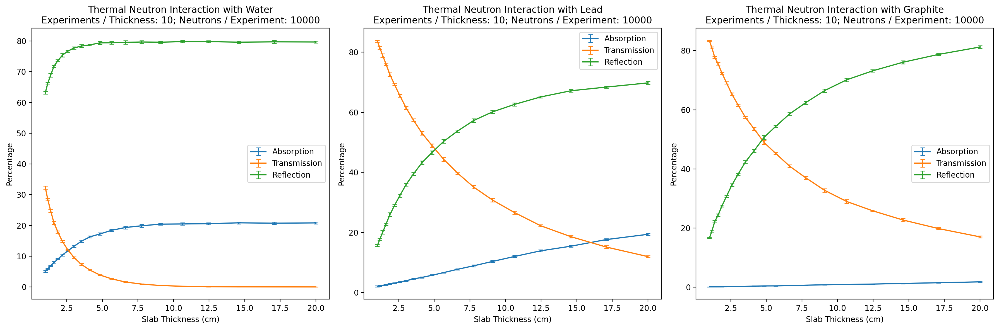

In [ ]:
THICKNESSES = np.geomspace(1, 20, 20)  # in cm
MATERIALS = [WATER, LEAD, GRAPHITE]
N_EXPERIMENTS = 10  # per thickness to determine the std of the means for each material
N_ENTERING = 10000  # number of neutrons entering the slab for each experiment

# Initialize dirs to store results
absorption_data = {material: [] for material in MATERIALS}
transmission_data = {material: [] for material in MATERIALS}
reflection_data = {material: [] for material in MATERIALS}

# Run simulations and store results
for thickness in tqdm(THICKNESSES, desc="Thickness", leave=True, position=0):
    results = perform_1d_constant_thickness_simulations(
        thickness, MATERIALS, N_EXPERIMENTS, N_ENTERING, progress_bar=False
    )
    for material in MATERIALS:
        material_key = f"{material}, {thickness} cm"
        absorption_data[material].append(results[material_key]["Absorbed"])
        transmission_data[material].append(results[material_key]["Transmitted"])
        reflection_data[material].append(results[material_key]["Reflected"])
# Create side-by-side plots
fig, axes = plt.subplots(
    nrows=1, ncols=len(MATERIALS), figsize=(6 * len(MATERIALS), 6), dpi=200
)

# plot the results
for i, material in enumerate(MATERIALS):
    ax = axes[i]
    ax.errorbar(
        THICKNESSES,
        [mean * 100 for mean, std in absorption_data[material]],
        yerr=[std * 100 for mean, std in absorption_data[material]],
        label="Absorption",
        capsize=3,
    )
    ax.errorbar(
        THICKNESSES,
        [mean * 100 for mean, std in transmission_data[material]],
        yerr=[std * 100 for mean, std in transmission_data[material]],
        label="Transmission",
        capsize=3,
    )
    ax.errorbar(
        THICKNESSES,
        [mean * 100 for mean, std in reflection_data[material]],
        yerr=[std * 100 for mean, std in reflection_data[material]],
        label="Reflection",
        capsize=3,
    )

    ax.set_title(
        f"Thermal Neutron Interaction with {material}\n"
        f"Experiments / Thickness: {N_EXPERIMENTS}; Neutrons / Experiment: {N_ENTERING}"
    )
    ax.set_xlabel("Slab Thickness (cm)")
    ax.set_ylabel("Percentage")
    ax.legend()
plt.tight_layout()
plt.show()


The results hold firm with the observations made above. First, we look the left ends of lead and graphite graphs, and again note that the closer the thickness to the mean path, the more similar probabilities for reflection and transmission become. When the slab thickness is sufficiently small for the two materials, transmission rate becomes higher than the reflection rate; and for lead, transmission and reflection become equal with higher thickness because it has a higher mean path than graphite. For the given `THICKNESSES`, the mean path of water is just too small to make such observations - however, it can be done with a smaller thickness (it happens around 0.5 cm with water - you can try with a finer `geomspace` if you like).

As expected, we also see that reflection and absorption increase with length. In general, the reflection rate increases more rapidly with increasing slab thickness because, as the slab becomes thicker, it becomes more difficult for neutrons to penetrate the material and transmit through it. Neutrons are more likely to scatter multiple times before they escape the material, and this increases the probability of reflection. We saw that this is especially true when the mean free path of the neutrons is significantly smaller than the slab thickness.

On the other hand, the absorption rate increases slower with increasing slab thickness because the probability of a neutron being absorbed depends on the absorption cross-section and the distance the neutron travels inside the material. Although the probability of absorption increases as the neutron travels further into the material, the number of neutrons available for absorption decreases as more and more neutrons are scattered or reflected. This leads to a slower rate of increase in the absorption rate compared to the reflection rate.

Also, we see that in all cases the transmission rate decreases. For water, we see that that the transmission rate becomes almost zero at the thicknesses of the given experiment - which would make it a good candidate for the job.

If the number of neutrons and simulations is sufficiently large, we should see no jitter in the sign of the derivative of the graphs - that is, the graphs always steadily increase or decrease to a constant value. That might not be the case if `N_EXPERIMENTS` or `N_ENTERING` is too small.

## Characteristic Attenuation Lenghts (with Scattering)

The transmission rate is of particular interest to us, as the characteristic attenuation length **with scattering** $\lambda$ can be inferred from it. It comes from all considered processes with many particles, and due to this, is should be larger than the nominal value. As a reminder, neutron transmission $I$ can be approximated by the Beer-Lambert law, where $I$ is the transmission, and $t$ is the thickness:

$$I=\exp\left({-\frac{t}{\lambda}}\right).$$

Therefore, the characteristic attenuation length of each material can be determined by taking $\ln{I}$, having removed the values which correspond to zero transmission. We will use the `transmission_data` dictionary created in the previous experiment.

Regarding the standard deviation of this quantity: $$f(I)=\ln(I)\implies df=\frac{dI}{I}\implies \sigma_f \approx \frac{\Delta I}{I}.$$

Similar as above, the bigger the error, the smaller the weight in the `np.polyfit` must be, while the error for the fit parameters is similarly determined from the covariance matrix.

Additionally, after the fit, standard deviation on the attenuation length will be $$\sigma_\lambda=\lambda\frac{\sigma_\text{slope}}{\text{slope}}.$$

Attenuation Length of Water: 1.85 ± 0.03 cm

Attenuation Length of Lead: 8.64 ± 0.26 cm

Attenuation Length of Graphite: 9.80 ± 0.47 cm



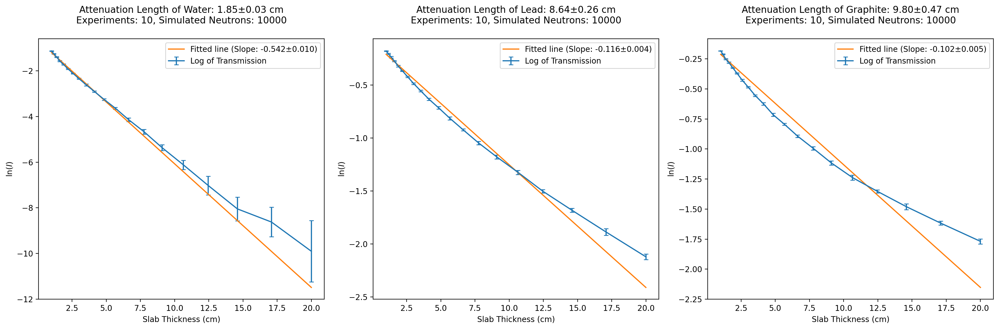

In [ ]:
# Create side-by-side plots
fig, axes = plt.subplots(
    nrows=1, ncols=len(MATERIALS), figsize=(6 * len(MATERIALS), 6), dpi=200
)

for i, material in enumerate(MATERIALS):
    ax = axes[i]
    # get the raw data and remove elements where the mean transmission is 0
    raw_transmission_array = np.array(
        [mean for mean, std in transmission_data[material] if mean > 0]
    )
    raw_transmission_std_array = np.array(
        [std for mean, std in transmission_data[material] if mean > 0]
    )
    current_thicknesses = [
        thickness
        for thickness, (mean, std) in zip(THICKNESSES, transmission_data[material])
        if mean > 0
    ]
    # obtain logged quanitities
    log_transmission_array = np.log(raw_transmission_array)
    log_transmission_std_array = raw_transmission_std_array / raw_transmission_array
    # plot the logged quantities
    ax.errorbar(
        current_thicknesses,
        log_transmission_array,
        yerr=log_transmission_std_array,
        label="Log of Transmission",
        capsize=3,
    )

    # Perform the weighted linear fit
    weights = 1 / log_transmission_std_array
    fit_params, fit_cov = np.polyfit(
        current_thicknesses, log_transmission_array, deg=1, w=weights, cov=True
    )
    slope, intercept = fit_params
    slope_err, intercept_err = np.sqrt(np.diag(fit_cov))

    # Calculate the characteristic attenuation length and its error
    attenuation_length = -1 / slope
    attenuation_length_err = np.abs(attenuation_length * (slope_err / slope))

    # Plot the fitted line
    fitted_line = np.poly1d(fit_params)
    ax.plot(
        current_thicknesses,
        fitted_line(current_thicknesses),
        label=f"Fitted line (Slope: {slope:.3f}±{slope_err:.3f})",
    )

    ax.set_title(
        f"Attenuation Length of {material}: {attenuation_length:.2f}±{attenuation_length_err:.2f} cm\n"
        f"Experiments: {N_EXPERIMENTS}, Simulated Neutrons: {N_ENTERING}\n"
    )
    ax.set_xlabel("Slab Thickness (cm)")
    ax.set_ylabel(r"$\ln(I)$")
    ax.legend()
    print(
        f"Attenuation Length of {material}: {attenuation_length:.2f} ± {attenuation_length_err:.2f} cm\n"
    )
plt.tight_layout()
plt.show()


Due to scattering, we indeed see that the obtained values are larger then the mean path.
<!-- As can be intuitively understood, results for attenuation length of a simulation sufficiently large should go *in the order* of the mean path. :
- Water: $\lambda\approx 2\pm$ cm, while the mean path is $0.29$ cm.
- Lead: $\lambda\approx 9$ cm, while the mean path is $2.67$ cm.
- Graphite: $\lambda\approx 10\pm$ cm, while the mean path is $2.52$ cm. -->

We also see that the errors generally increase on the plotted logged transmission. This is due to the way the error is formulated (shown in the previous markdown), that is, there is division by very small transmission.

Additionally, we see a rather systematic trend for all graphs (least prominent in water and most prominent for graphite) - at first, the linear fit underestimates logged transmission, then overestimates, and then underestimates again. This can be understood in terms of the slopes of absorption, transmission and reflection in the non-logged graph, and the fact that a logged quantity gets its standard deviation 'shifted'.

Again, our simulation is isotropic. Out of all the materials, this is the biggest stretch for graphite - the scattering would be "most" noticeably unisotropic compared to the other materials due its crystalline structure.

For water, we can compare the order of magnitude of our finding to the experimental **diffusion length** (James A. DeJuren, & Hyman Rosenwasser (1953). Diffusion Length of Thermal Neutrons in Water. *Journal of Research of the National Bureau of Standards*) , which refers to the average distance a neutron travels in a material before being absorbed, taking into account the fact that the neutron may be scattered multiple times before it gets absorbed. The experimental value at the temperature of 22 $^\circ$ Celsius was $2.763\pm0.015$ cm. This implies that the obtained attenuation length is smaller than the diffusion length.

Generally however, we would expect the attenuation length to be larger than diffusion length. This is because all of the materials we consider do not have huge absorption probabilities. Consequently, neutrons can travel relatively long distances in water before their intensity decreases significantly. As we saw above, for all materials considered, our simulation implies that the attenuation length is dominated by scattering. However, it is great that our result is of the same order of magnitude.

This may come down to our isotropic approximation. Of course, this assumes that the properties we inputted for all materials at the beginning of the notebook are correct. For lead and graphite, I could not find analogous measurements.

## A Note on the Electron Gamma Shower Method

Previously in this work, we defined the total cross section for all processes, $\Sigma_T=\sum_{i}^{} \Sigma_i$, and then were able to use the mean free path $\lambda_T=\frac{1}{\Sigma_T}$ for the step as $-\lambda_T=\log(u_i)$. This works pretty well for the cases of simple geometries.

However, all scattering processes can also be studied individually - for example, with the Electron Gamma Show (EGS) method. It does not calculate the representative mean free path, but instead, probability of a certain process i becomes $$P(i)=\exp{-\frac{x}{\lambda_i}}.$$ If we consider absorption $a$ and scattering $s$, and generate two random numbers, $u_m$ and $u_n$, we now have two step sizes: $$s_a=-\lambda_a\log(u_m),$$ $$s_s=-\lambda_s\log(u_n).$$ Finally, the actual step size is chosen from whatever of the generated random quantities is smaller: $$s=\min[s_a,s_s].$$

Albeit this is more intuitive than what we used above, the computational time will be larger, as we have the more operations to do, while the modelled physics is exactly the same.

## Woodcock Method

Modelling the boundary between two differents materials with different $\lambda$'s can be computationally demanding and complicated, as a step generated in a single material becomes incorrect when performing that step the neutron ends up in the different material. The workaround for this is using **delta tracking** introduced in the Woodcock method. For the barrier of two different materials, the majorant cross section is chosen: $$\Sigma_T=\max(\Sigma_1,\Sigma_2),$$ hence the chosen mean path is $$\lambda=\min(\lambda_1,\lambda_2).$$ Therefore, the step size is $$s=-\lambda\ln u,$$ where $u$ is sampled as usual. This is always the case, even in the material with a different $\lambda$, in which the steps are *shorter* than they should be. **This is moderated by the fact that majority of the steps in the material with a larger mean free path are *fictitious*, and are in the same direction the previous one**. For the larger mean free path material, whether the step is fictitious is decided by generated a random sampled number $u_f$ from 0 to 1. Then, if the condition $$u_f<1-\frac{\Sigma_{T\operatorname{current\space material}}}{\max(\Sigma_{T1}, \Sigma_{T2})}$$ is satisfied, the step is in the same direction, i.e. fictitious. If the condition is not satisfied, absorption ar scattering is allowed to happen, with the probabilities of the material *that the neutron is currently in*.

These fictitious steps can be proven to make the cross sections of both materials represented accurately.

We will use the the Woodcock method to simulate two layers of stacked materials and calculate the fraction of neutrons transmitted through; each layer is of thickness 10 cm. Again, neutrons are incident in $x_+$, and the slabs are infinite in the $y$ and $z$ dimensions.

For statistics, the Woodcock method is implemented below for two materials of lengths `thickness_1` and `thickness_2` - in the case of a fictitious step, the norm of the previous step and random sampling is used to generate the length of the new step while keeping the direction the same. `n_neutrons_delta_tracking_1d_mc_statistics` uses a very similar Numpy slicing and masking approach as `n_neutrons_delta_tracking_1d_mc_statistics` did.

In [ ]:
def n_neutrons_delta_tracking_1d_mc_statistics(
    thickness_1,
    thickness_2,
    material_1,
    material_2,
    n_entering,
):
    """
    This function simulates the path of a specified number of neutrons through two materials in 1D using
    the delta tracking Monte Carlo method. The simulation runs until there are no neutrons left.

    Parameters
    ----------
    thickness_1 : float
        The thickness of the first material in cm.
    thickness_2 : float
        The thickness of the second material in cm.
    material_1 : Material
        The first material the neutrons travel through.
    material_2 : Material
        The second material the neutrons travel through.
    n_entering : int
        The number of neutrons entering the first material.

    Returns
    -------
    tuple
        A tuple containing the number of neutrons absorbed in material 1, absorbed in material 2,
        transmitted and reflected through both materials.

    """
    # Initialize the counters
    num_reflected = num_absorbed_1 = num_absorbed_2 = num_transmitted = 0
    # Determine the mean free path and fictitious probability according to PDF
    mfp = min(material_1.mean_path, material_2.mean_path)
    # the fictitious prob is stated in terms of mfp's
    fictitious_prob = 1 - min(material_1.mean_path, material_2.mean_path) / max(
        material_1.mean_path, material_2.mean_path
    )
    # Determine the limits of the longer and shorter mfp regions
    #  and corresponding materials. No first if because it
    # wouldn't work for two identical materials
    longer_mfp_limits = {"start": 0, "end": thickness_1}
    shorter_mfp_limits = {"start": thickness_1, "end": thickness_1 + thickness_2}
    longer_mfp_material = material_1
    shorter_mfp_material = material_2
    # If material_2 has a longer mean free path, swap the limits and materials
    if material_2.mean_path > material_1.mean_path:
        longer_mfp_limits = {"start": thickness_1, "end": thickness_1 + thickness_2}
        shorter_mfp_limits = {"start": 0, "end": thickness_1}
        longer_mfp_material = material_2
        shorter_mfp_material = material_1
    # Set the positions of neutrons at the origin and directions
    particle_positions = np.zeros((n_entering, 1))
    # Make sure x_0 is positive
    previous_directions = np.zeros((n_entering, 1))
    previous_directions[:, 0] = 1

    # Generate step lengths
    step_lengths = -mfp * np.log(
        np.random.uniform(size=(particle_positions.shape[0], 1))
    )

    # update positions
    particle_positions = particle_positions + step_lengths * previous_directions

    # Calculate the statistics and directions
    are_transmitted = particle_positions[:, 0] > thickness_1 + thickness_2
    num_transmitted += np.count_nonzero(are_transmitted)
    particle_positions = particle_positions[~are_transmitted]
    previous_directions = previous_directions[~are_transmitted]

    # Find the indexing for both regions
    are_in_longer_mfp = (longer_mfp_limits["start"] <= particle_positions[:, 0]) & (
        particle_positions[:, 0] <= longer_mfp_limits["end"]
    )

    # Where did they get absorbed?
    are_absorbed_longer = (
        np.random.uniform(size=particle_positions.shape[0])
        < longer_mfp_material.absorption_probability
    )

    are_absorbed_shorter = (
        np.random.uniform(size=particle_positions.shape[0])
        < shorter_mfp_material.absorption_probability
    )

    # combine
    are_absorbed = np.where(
        are_in_longer_mfp, are_absorbed_longer, are_absorbed_shorter
    )

    # Are the steps fictitious?
    are_fictitious = (
        np.random.uniform(size=particle_positions.shape[0]) < fictitious_prob
    )
    are_absorbed = ((~are_in_longer_mfp) | (~are_fictitious)) & are_absorbed
    are_in_material_1 = (particle_positions[:, 0] >= 0) & (
        particle_positions[:, 0] < thickness_1
    )
    are_in_material_2 = (particle_positions[:, 0] >= thickness_1) & (
        particle_positions[:, 0] <= thickness_1 + thickness_2
    )
    # Update the statistics
    num_absorbed_1 += np.count_nonzero(are_absorbed & are_in_material_1)
    num_absorbed_2 += np.count_nonzero(are_absorbed & are_in_material_2)
    particle_positions = particle_positions[
        ~(are_absorbed & (are_in_material_1 | are_in_material_2))
    ]
    # Get previous directions
    previous_directions = previous_directions[
        ~(are_absorbed & (are_in_material_1 | are_in_material_2))
    ]
    # Run similar loop until there are no neutrons left
    while particle_positions.shape[0] > 0:
        # generate directions
        directions = np.random.randn(particle_positions.shape[0], 3)
        directions /= np.sqrt(np.einsum("...i,...i->...", directions, directions))[
            :, None
        ]
        # get the x component
        directions = directions[:, :1]
        # generate step lengths
        step_lengths = -mfp * np.log(
            np.random.uniform(size=(particle_positions.shape[0], 1))
        )

        # find which neutrons are in the longer mfp region
        are_in_longer_mfp = (longer_mfp_limits["start"] <= particle_positions[:, 0]) & (
            particle_positions[:, 0] <= longer_mfp_limits["end"]
        )
        # find which steps are fictitious
        are_fictitious = (
            np.random.uniform(size=particle_positions.shape[0]) < fictitious_prob
        )
        # combine the arrays
        are_combined = are_in_longer_mfp & are_fictitious
        # update the positions
        particle_positions[are_combined] = (
            particle_positions[are_combined]
            + step_lengths[are_combined] * previous_directions[are_combined]
        )
        # update are_combined with compliment
        are_combined = are_in_longer_mfp & (~are_fictitious)
        # update corresponding positions
        particle_positions[are_combined] = (
            particle_positions[are_combined]
            + step_lengths[are_combined] * directions[are_combined]
        )
        # update previous directions
        previous_directions[are_combined] = directions[are_combined]

        # take compliment for shorter mfp region, and repeat the same steps
        are_combined = ~are_in_longer_mfp
        particle_positions[are_combined] = (
            particle_positions[are_combined]
            + step_lengths[are_combined] * directions[are_combined]
        )
        # update previous directions
        previous_directions[are_combined] = directions[are_combined]
        # update the indexing arrays
        are_in_longer_mfp = (longer_mfp_limits["start"] <= particle_positions[:, 0]) & (
            particle_positions[:, 0] <= longer_mfp_limits["end"]
        )
        are_in_shorter_mfp = (
            shorter_mfp_limits["start"] <= particle_positions[:, 0]
        ) & (particle_positions[:, 0] <= shorter_mfp_limits["end"])
        # find which neutrons are absorbed in longer and shorter mfp regions
        are_absorbed_longer = (
            np.random.uniform(size=particle_positions.shape[0])
            < longer_mfp_material.absorption_probability
        )
        are_absorbed_shorter = (
            np.random.uniform(size=particle_positions.shape[0])
            < shorter_mfp_material.absorption_probability
        )
        # combine the arrays for popping
        are_absorbed = np.where(
            are_in_longer_mfp, are_absorbed_longer, are_absorbed_shorter
        )
        are_absorbed = (
            (are_in_longer_mfp & (~are_fictitious)) | are_in_shorter_mfp
        ) & are_absorbed
        # get where they got absorbed
        are_in_material_1 = (particle_positions[:, 0] >= 0) & (
            particle_positions[:, 0] < thickness_1
        )
        are_in_material_2 = (particle_positions[:, 0] >= thickness_1) & (
            particle_positions[:, 0] <= thickness_1 + thickness_2
        )
        num_absorbed_1 += np.count_nonzero(are_absorbed & are_in_material_1)
        num_absorbed_2 += np.count_nonzero(are_absorbed & are_in_material_2)
        # update the positions and directions
        particle_positions = particle_positions[
            ~(are_absorbed & (are_in_material_1 | are_in_material_2))
        ]
        previous_directions = previous_directions[
            ~(are_absorbed & (are_in_material_1 | are_in_material_2))
        ]

        # Update the statistics
        are_reflected = particle_positions[:, 0] < 0
        are_transmitted = particle_positions[:, 0] > thickness_1 + thickness_2
        num_reflected += np.count_nonzero(are_reflected)
        num_transmitted += np.count_nonzero(are_transmitted)
        particle_positions = particle_positions[~(are_reflected | are_transmitted)]
        previous_directions = previous_directions[~(are_reflected | are_transmitted)]
    return num_absorbed_1, num_absorbed_2, num_transmitted, num_reflected


Additionally, as we would like to perform `n_experiments` for the Woodcock method to calculate the mean and standard deviation values and to print the results in a pretty way from a dictionary, we just reimplement functions already used above to create `perform_1d_constant_thickness_simulations_delta` and `print_formatted_results_delta`:

In [ ]:
def perform_1d_constant_thickness_simulations_delta(
    thickness_1, thickness_2, material_1, material_2, n_experiments, n_entering
):
    """
    Performs a number of 1D Monte Carlo simulations of neutron transport through two materials of constant thickness,
    and calculates the mean and standard deviation of the number of absorbed, transmitted, and reflected neutrons.

    Parameters
    ----------
    thickness_1 : float
        Thickness of the first material in the slab (in centimeters).

    thickness_2 : float
        Thickness of the second material in the slab (in centimeters).

    material_1 : Material
        Instance of Material class representing the first material.

    material_2 : Material
        Instance of Material class representing the second material.

    n_experiments : int
        Number of independent Monte Carlo simulations to perform.

    n_entering : int
        Number of neutrons entering the slab in each simulation.

    Returns
    -------
    dict
        Dictionary containing the results of the simulations. Each key is a string representation of the
        material and thickness, and the value is another dictionary containing the mean and standard
        deviation of the number of absorbed, transmitted, and reflected neutrons, along with the number
        of experiments and neutrons per experiment.
    """
    results = (
        {}
    )  # Initialize an empty dictionary to store the results for each material

    # Initialize empty lists to store the results for each experiment
    (
        absorption_1_results,
        absorption_2_results,
        transmission_results,
        reflection_results,
    ) = ([], [], [], [])

    # Iteratate thru the experiments
    for _ in tqdm(
        range(n_experiments),
        desc="Experiments with " + str(material_1) + " and " + str(material_2),
        leave=True,
        position=0,
    ):
        # Run the simulation
        (
            num_absorbed_1,
            num_absorbed_2,
            num_transmitted,
            num_reflected,
        ) = n_neutrons_delta_tracking_1d_mc_statistics(
            thickness_1, thickness_2, material_1, material_2, n_entering
        )
        absorption_1_results.append(num_absorbed_1)
        absorption_2_results.append(num_absorbed_2)
        transmission_results.append(num_transmitted)
        reflection_results.append(num_reflected)
        tqdm._instances.clear()
    # Calculate the mean and standard deviation for each outcome
    absorption_1_mean_std = (
        np.mean(absorption_1_results) / n_entering,
        np.std(absorption_1_results) / n_entering,
    )
    absorption_2_mean_std = (
        np.mean(absorption_2_results) / n_entering,
        np.std(absorption_2_results) / n_entering,
    )
    transmission_mean_std = (
        np.mean(transmission_results) / n_entering,
        np.std(transmission_results) / n_entering,
    )
    reflection_mean_std = (
        np.mean(reflection_results) / n_entering,
        np.std(reflection_results) / n_entering,
    )

    # Save the results in the dictionary
    results[f"{material_1}, {thickness_1} cm, and {material_2}, {thickness_2} cm"] = {
        "Experiments": n_experiments,
        "Neutrons / experiment": n_entering,
        f"Absorbed in {material_1} (material 1)": absorption_1_mean_std,
        f"Absorbed in {material_2} (material 2)": absorption_2_mean_std,
        "Transmitted": transmission_mean_std,
        "Reflected": reflection_mean_std,
    }
    return results


def print_formatted_results_delta(results):
    """
    Prints the results of Monte Carlo simulations of neutron transport in a formatted manner.

    Parameters
    ----------
    results : dict
        Dictionary containing the results of the simulations. Each key is a string representation of the
        material and thickness, and the value is another dictionary containing the mean and standard
        deviation of the number of absorbed, transmitted, and reflected neutrons, along with the number
        of experiments and neutrons per experiment.

    Returns
    -------
    None
    """

    print("Results Summary")
    print("===============")
    for materials, data in results.items():
        # Extract material names
        material_1, material_2 = [
            material.strip() for material in materials.split(" and ")
        ]

        print(f"Materials: {materials}")
        print(f"Number of Experiments: {data['Experiments']}")
        print(f"Neutrons per experiment: {data['Neutrons / experiment']}")

        absorbed_1_mean, absorbed_1_std = data[
            f"Absorbed in {material_1.split(',')[0]} (material 1)"
        ]
        absorbed_2_mean, absorbed_2_std = data[
            f"Absorbed in {material_2.split(',')[0]} (material 2)"
        ]
        transmitted_mean, transmitted_std = data["Transmitted"]
        reflected_mean, reflected_std = data["Reflected"]

        print(
            f"  Absorbed in {material_1.split(',')[0]} (Region 1): {absorbed_1_mean * 100:.2f}% (±{absorbed_1_std * 100:.2f}%)"
        )
        print(
            f"  Absorbed in {material_2.split(',')[0]} (Region 2): {absorbed_2_mean * 100:.2f}% (±{absorbed_2_std * 100:.2f}%)"
        )
        print(
            f"  Transmitted: {transmitted_mean * 100:.2f}% (±{transmitted_std * 100:.2f}%)"
        )
        print(f"  Reflected: {reflected_mean * 100:.2f}% (±{reflected_std * 100:.2f}%)")
        print()


### Visualizing Woodcock with Planes Separating the Material Boundaries

Additionally, it would be nice to visualize the behaviour inside the two slabs for the Woodcock method. Instead of reusing `get_isotropic_vectors_with_x0_positive` and `get_isotropic_exponential_steps_with_x0_positive` again and do a lot of scrolling, let's reimplement a step generator `generate_3d_step` to have it conveniently inside `single_neutron_delta_tracking_1d_mc_with_history`. The logic is identical as above, but the simulation is performed for a single neutron to track its position history.

In [ ]:
def single_neutron_delta_tracking_1d_mc_with_history(
    material_1, material_2, thickness_1, thickness_2
):
    """
    Simulate the path of a single neutron through two materials in 1D using
    delta tracking Monte Carlo method.

    Parameters
    ----------
    material_1 : Material
        The first material the neutron travels through.
    material_2 : Material
        The second material the neutron travels through.
    thickness_1 : float
        The thickness of material_1 in cm.
    thickness_2 : float
        The thickness of material_2 in cm.

    Returns
    -------
    tuple
        A tuple containing the outcome of the simulation ("Reflected", "Transmitted", or "Absorbed")
        and the particle position history.
    """

    def generate_3d_step(mean_path, first_step=False):
        """
        Generate a 3D step for a random walk with a given mean free path length.

        The function uses isotropic scattering, meaning the step direction is chosen
        uniformly at random from all possible directions. The step length is determined
        by sampling an exponential distribution with the given mean free path.

        Parameters
        ----------
        mean_path : float
            Mean free path length for the random walk step.
        first_step : bool, optional
            If True, ensures that the first step is positive in the x-direction.
            Default is False.

        Returns
        -------
        step : numpy.ndarray
            A 3D step vector with shape (3,).
        """
        # Sample random angles for isotropic scattering
        phi = 2 * np.pi * np.random.uniform(low=0, high=1)
        theta = np.arccos(2 * np.random.uniform(low=0, high=1) - 1)

        # Calculate the step length by sampling from an exponential distribution
        # with the given mean free path
        step_length = -mean_path * np.log(np.random.uniform(low=0, high=1))

        # Calculate the 3D step vector using spherical coordinates
        step = step_length * np.array(
            [
                np.sin(theta) * np.cos(phi),
                np.sin(theta) * np.sin(phi),
                np.cos(theta),
            ]
        )

        if first_step:
            return np.array([1, 0, 0]) * step_length
        return step

    # Sort materials by mean free path
    smaller_mfp_material, larger_mfp_material = sorted(
        [material_1, material_2], key=lambda m: m.mean_path
    )
    smaller_mfp, larger_mfp = (
        smaller_mfp_material.mean_path,
        larger_mfp_material.mean_path,
    )

    # Calculate the denominator in the fictitious probability
    fictitious_denominator = max(material_1.total_section, material_2.total_section)

    # Initialize particle position, position history, and step variables
    particle_position = np.array([0.0, 0.0, 0.0])
    particle_position_history = np.array([particle_position])
    current_step = generate_3d_step(smaller_mfp, first_step=True)
    particle_position = particle_position + current_step
    particle_position_history = np.vstack((particle_position_history, particle_position))



    while True:
        # Determine if the particle is in material 1 or material 2
        in_material_1 = 0 <= particle_position[0] <= thickness_1
        in_material_2 = thickness_1 <= particle_position[0] <= thickness_1 + thickness_2

        # Set the current material and the other material
        current_material = material_1 if in_material_1 else material_2
        other_material = material_2 if in_material_1 else material_1  # Not used

        # Calculate the fictitious probability in terms of sections
        fictitious_prob = 1 - current_material.total_section / fictitious_denominator

        # Check if the particle is absorbed
        if np.random.uniform(0, 1) < current_material.absorption_probability:
            outcome = "Absorbed"
            break
        # Determine if the step is fictitious or real
        is_fictitious = (
            str(current_material) == str(larger_mfp_material)
            and np.random.uniform(low=0, high=1) <= fictitious_prob
        )

        # Update particle position based on whether the step is fictitious or real
        if is_fictitious:
            # sample new step length
            new_step_length = -smaller_mfp * np.log(np.random.uniform(low=0, high=1))
            # but keep direction the same
            current_step = (
                current_step / np.linalg.norm(current_step)
            ) * new_step_length
            particle_position += current_step  # Make a fictitious step
        else:
            current_step = generate_3d_step(smaller_mfp, first_step=False)
            particle_position += current_step  # Make a real step
        # Update particle position history
        particle_position_history = np.vstack(
            (particle_position_history, particle_position)
        )

        # Check for reflection or transmission
        if particle_position[0] < 0:
            outcome = "Reflected"
            break
        elif particle_position[0] > thickness_1 + thickness_2:
            outcome = "Transmitted"
            break
    return outcome, particle_position_history


Now, we can conveniently call `single_neutron_delta_tracking_1d_mc_with_history` inside `plot_random_events_delta`. This creates 9 events on the spot and plots them on a 3X3 figure (note again that the long runtime is from creation 9 plots with a lot of points). Planes are added to the starts and the ends of the relevant regions - the entry material plane is shown in brown, the second material entry plane is shown in orange, whilst the exit plane is shown in yellow.

In [ ]:
def plot_random_events_delta(
    thickness_1,
    thickness_2,
    material_1,
    material_2,
):
    """
    Plots a 3D visualization of 9 random neutron trajectories through a two-material slab.

    This function generates neutron trajectories by simulating their transport
    through the slab using the delta tracking Monte Carlo method. The plot includes
    the entry and exit points, trajectory lines, and transparent planes representing
    the materials.

    Parameters
    ----------
    thickness_1 : float
        Thickness of the first material in the slab (in centimeters).

    thickness_2 : float
        Thickness of the second material in the slab (in centimeters).

    material_1 : Material
        First material in the slab.

    material_2 : Material
        Second material in the slab.

    Returns
    -------
    None
        The function generates a plot and does not return any values.
    """
    print(f"Plotting random events for {material_1} and {material_2}:")
    # Create a list to hold the outcomes and position histories
    random_events = []

    # Run the simulation 9 times to get the outcomes and position histories
    for _ in range(9):
        outcome, position_history = single_neutron_delta_tracking_1d_mc_with_history(
            material_1, material_2, thickness_1, thickness_2
        )
        random_events.append((outcome, position_history))

    # Create a figure
    fig = plt.figure(figsize=(15, 15), dpi=150)

    # Add the material names and thicknesses to the figure title
    fig.suptitle(
        f"Region 1: {material_1}, {thickness_1} cm; Region 2: {material_2}, {thickness_2} cm",
        fontsize=16,
        y=0.92,
    )

    # Iterate over the random_events
    for i, (outcome, position_history) in enumerate(random_events):
        # Create a subplot for each sampled event
        ax = fig.add_subplot(3, 3, i + 1, projection="3d")

        # Plot the position history points
        for j in range(position_history.shape[0]):
            ax.scatter(
                position_history[j, 0],
                position_history[j, 1],
                position_history[j, 2],
                c="black",
                s=10,
                alpha=0.5,
            )
        # Plot the trajectory lines
        ax.plot(
            position_history[:, 0],
            position_history[:, 1],
            position_history[:, 2],
            alpha=0.5,
        )

        # Set the labels and colors based on the outcome
        start_label = "Entry point"
        end_label = f"{outcome} point"
        start_color = "green"
        end_color = "red" if outcome == "Absorbed" else "blue"

        # Plot the entry and exit points
        ax.scatter(
            position_history[0, 0],
            position_history[0, 1],
            position_history[0, 2],
            c=start_color,
            label=start_label,
        )
        ax.scatter(
            position_history[-1, 0],
            position_history[-1, 1],
            position_history[-1, 2],
            c=end_color,
            label=end_label,
        )

        # Create the legend proxy artists
        green_point = Line2D(
            [0], [0], linestyle="none", marker="o", color="green", label=start_label
        )
        end_point = Line2D(
            [0], [0], linestyle="none", marker="o", color=end_color, label=end_label
        )
        legend_handles = [green_point, end_point]

        # Set the title and labels
        num_steps = position_history.shape[0] - 1
        ax.set_title(f"Event {i + 1}: {outcome}, Steps: {num_steps}")
        ax.set_xlabel("X")
        ax.set_ylabel("Y")
        ax.set_zlabel("Z")
        ax.legend()

        # Create a transparent plane parallel to the Y and Z axes at x=0
        yy_entry, zz_entry = np.meshgrid(
            np.linspace(
                np.min(position_history[:, 1]), np.max(position_history[:, 1]), 2
            ),
            np.linspace(
                np.min(position_history[:, 2]), np.max(position_history[:, 2]), 2
            ),
        )
        # plot entry plane, add to legend
        ax.plot_surface(
            0, yy_entry, zz_entry, alpha=0.3, color="brown", label=material_1.name
        )
        brown_patch = mpatches.Patch(color="brown", label=material_1.name, alpha=0.3)
        legend_handles.append(brown_patch)

        # Create a transparent plane parallel to the Y and Z axes at x=THICKNESS_1 if it reached the second material
        if np.max(position_history[:, 0]) >= thickness_1:
            ax.plot_surface(
                thickness_1,
                yy_entry,
                zz_entry,
                alpha=0.3,
                color="orange",
                label=material_2.name,
            )
            orange_patch = mpatches.Patch(color="orange", label=material_2.name, alpha=0.3)
            legend_handles.append(orange_patch)

        # Create a transparent plane parallel to the Y and Z axes at x=2 THICKNESS_1 + THICKNESS_2 if it got transmitted
        if outcome == "Transmitted":
            ax.plot_surface(
                thickness_1 + thickness_2,
                yy_entry,
                zz_entry,
                alpha=0.3,
                color="yellow",
                label="Slab End",
            )
            yellow_patch = mpatches.Patch(color="yellow", label="Slab End", alpha=0.3)
            legend_handles.append(yellow_patch)

        # Add the legend
        ax.legend(handles=legend_handles)
    plt.show()




Finally, putting it all together:

In [ ]:
def run_and_display_delta_tracking_experiment(
    thickness_1, thickness_2, material_1, material_2, n_experiments, n_entering
):
    """
    Executes the delta tracking experiment, prints the formatted results, and plots the random events.

    Parameters
    ----------
    thickness_1 : float
        Thickness of the first material in the slab (in centimeters).

    thickness_2 : float
        Thickness of the second material in the slab (in centimeters).

    material_1 : Material
        Instance of Material class representing the first material.

    material_2 : Material
        Instance of Material class representing the second material.

    n_experiments : int
        Number of independent Monte Carlo simulations to perform.

    n_entering : int
        Number of neutrons entering the slab in each simulation.

    Returns
    -------
    None
    """
    print_formatted_results_delta(
        perform_1d_constant_thickness_simulations_delta(
            thickness_1, thickness_2, material_1, material_2, n_experiments, n_entering
        )
    )
    plot_random_events_delta(thickness_1, thickness_2, material_1, material_2)


## Woodcock Method Experiments

Now, we can perform experiments with `MATERIAL_1` and `MATERIAL_2` with `THICKNESS_1` and `THICKNESS_2`. As the first example that will verify our results, it's interesting to take a look at graphite as the first layer and water as the second. Graphite has the smallest absorption probability, while water has the highest - thus, we expect the results to deviate by a small amount.

Rerun the cell a few times see more interesting plots, or just call `plot_random_events_delta(thickness_1, thickness_2, material_1, material_2)` as defined above.

Again, note that `perform_1d_constant_thickness_simulations_delta` is very fast (takes less than 10s with 10k neutrons and 10 experiments), but plotting takes time.

Experiments with Graphite and Water:   0%|          | 0/10 [00:00<?, ?it/s]

Results Summary
Materials: Graphite, 10 cm, and Water, 10 cm
Number of Experiments: 10
Neutrons per experiment: 10000
  Absorbed in Graphite (Region 1): 1.38% (±0.10%)
  Absorbed in Water (Region 2): 13.59% (±0.22%)
  Transmitted: 0.19% (±0.05%)
  Reflected: 84.84% (±0.20%)

Plotting random events for Graphite and Water:


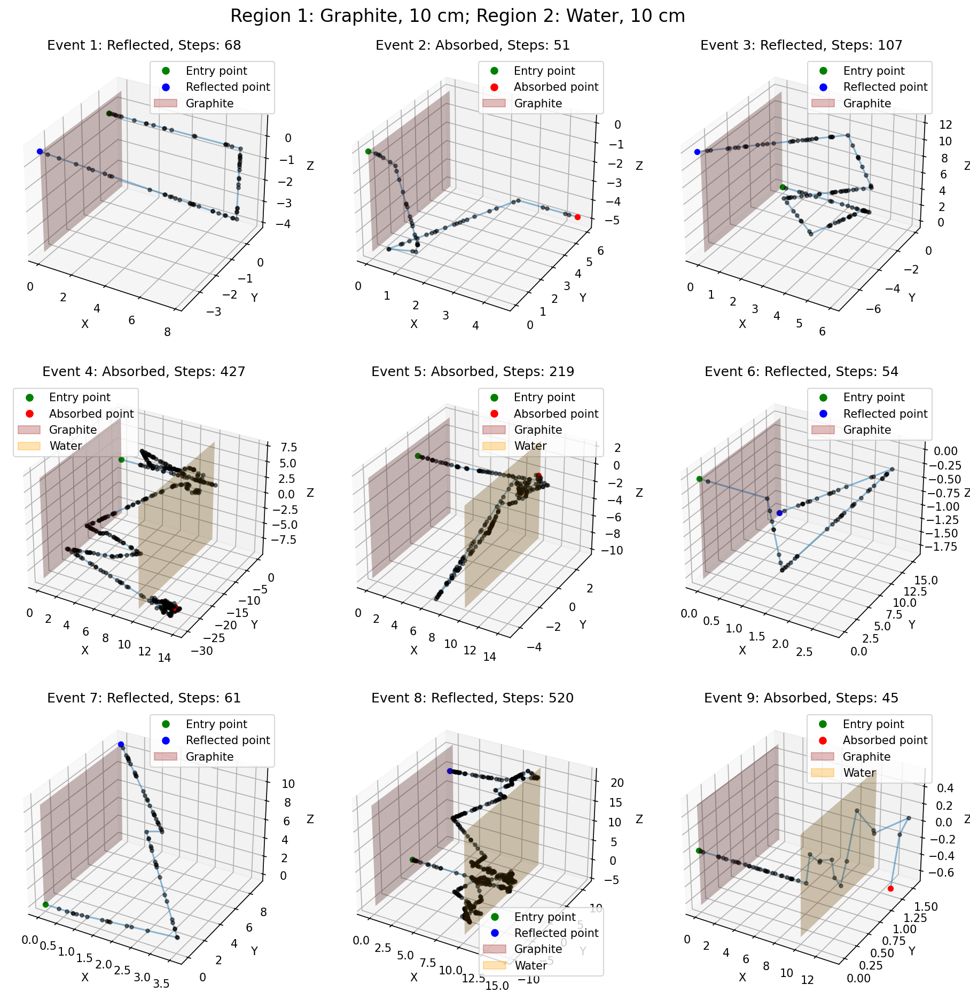

In [ ]:
THICKNESS_1, THICKNESS_2 = 10, 10  # cm
MATERIAL_1, MATERIAL_2 = GRAPHITE, WATER
N_EXPERIMENTS = 10  # Number of experiments to run
N_ENTERING = 10000  # Neutrons in each experiment


run_and_display_delta_tracking_experiment(
    thickness_1=THICKNESS_1,
    thickness_2=THICKNESS_2,
    material_1=MATERIAL_1,
    material_2=MATERIAL_2,
    n_experiments=N_EXPERIMENTS,
    n_entering=N_ENTERING,
)


This is indeed is the case - for just water of this thickness, absorption was ~20%, and reflection 80%. In this configuration, we expect that two most expected ways for a neutron to terminate is either being reflected from the graphite (the dominant majority of the reflections) or managing to get through the graphite and being absorbed in the water. As usual, these effects are amplified by the isotropic nature of the simulation.

Unless you've gotten very unlucky, it's evident that the majority of steps in the material with a longer mean path (graphite) are fictitious, and none are in the one with the shorter mean path (water).

Additionally, we can validate the results by making an experiment with a vacuum "slab" of `THICKNESS_1` in front of the material slab of 10 cm - the results should be the same as when we did the experiment for the latter individually. Additionally, we should see that all the steps in vacuum are fictitious. Say, for water:

Experiments with Vacuum and Water:   0%|          | 0/10 [00:00<?, ?it/s]

Results Summary
Materials: Vacuum, 10 cm, and Water, 10 cm
Number of Experiments: 10
Neutrons per experiment: 10000
  Absorbed in Vacuum (Region 1): 0.00% (±0.00%)
  Absorbed in Water (Region 2): 20.06% (±0.49%)
  Transmitted: 0.33% (±0.07%)
  Reflected: 79.61% (±0.46%)

Plotting random events for Vacuum and Water:


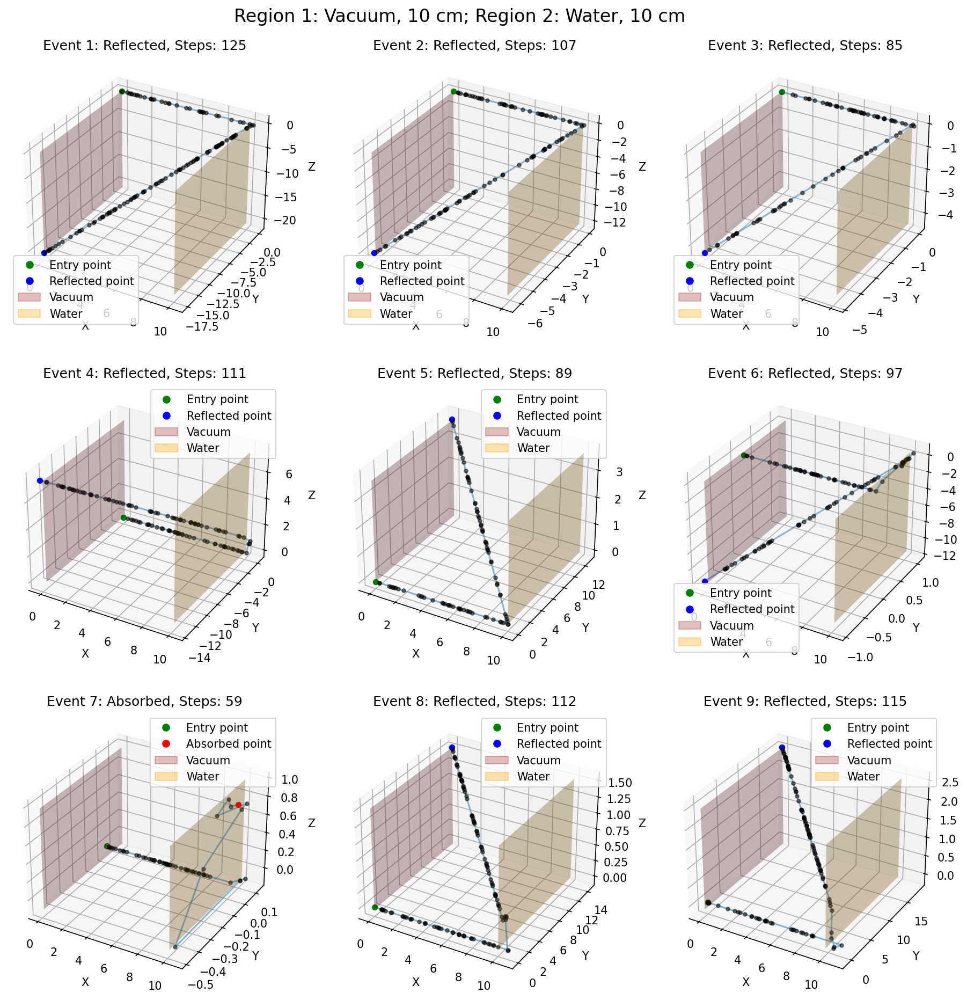

In [ ]:
THICKNESS_1, THICKNESS_2 = 10, 10 # cm
MATERIAL_1, MATERIAL_2 = VACUUM, WATER
N_EXPERIMENTS = 10 # Number of experiments to run
N_ENTERING = 10000 # Neutrons in each experiment

run_and_display_delta_tracking_experiment(
    thickness_1=THICKNESS_1,
    thickness_2=THICKNESS_2,
    material_1=MATERIAL_1,
    material_2=MATERIAL_2,
    n_experiments=N_EXPERIMENTS,
    n_entering=N_ENTERING,
)

And indeed, everything matches up.

Finally, as we've implemented variable thicknesses, we can also check if the results for two slabs from identical material are exactly the same as we got from a single slab. Then, the probability of a fictitious step would be zero, and we would also expect to see this from the plots. Let's pick water, so that the sum of the layer thicknesses is 10 cm:

Experiments with Water and Water:   0%|          | 0/10 [00:00<?, ?it/s]

Results Summary
Materials: Water, 6 cm, and Water, 4 cm
Number of Experiments: 10
Neutrons per experiment: 10000
  Absorbed in Water (Region 1): 19.24% (±0.47%)
  Absorbed in Water (Region 2): 0.91% (±0.09%)
  Transmitted: 0.34% (±0.05%)
  Reflected: 79.50% (±0.45%)

Plotting random events for Water and Water:


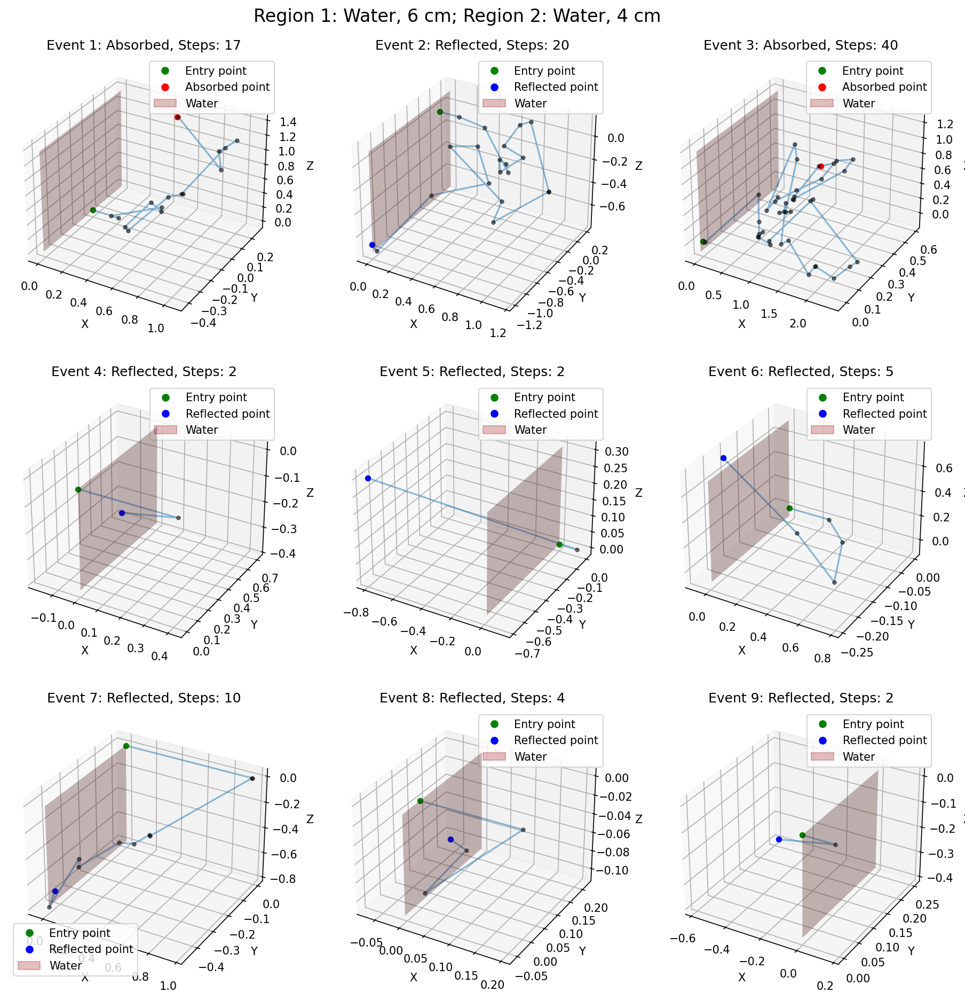

In [ ]:
THICKNESS_1, THICKNESS_2 = 6, 4 # cm
MATERIAL_1, MATERIAL_2 = WATER, WATER
N_EXPERIMENTS = 10 # Number of experiments to run
N_ENTERING = 10000 # Neutrons in each experiment

run_and_display_delta_tracking_experiment(
    thickness_1=THICKNESS_1,
    thickness_2=THICKNESS_2,
    material_1=MATERIAL_1,
    material_2=MATERIAL_2,
    n_experiments=N_EXPERIMENTS,
    n_entering=N_ENTERING,
)

The numerical results match the results with a method which considered only a single material, and the plots show that none of the steps were fictitious. Additionally, as expected, much more neutrons get absorbed in the first region than the second one.

## Animating the History of a Single Neutron

First, let's reuse our old `single_neutron_1d_mc_with_position_history` function to create an animation of a single neutron in a single material slab. This is done with `FuncAnimation`, and shown in the notebook using IPython. Again, it's not the simulation which takes time (it's a single neutron), but outputting the animation.

As before, the neutron's starting point is shown in green. The endpoint of the neutron that is absorbed is shown in red, and the endpoint of the neutrons that is either reflected or transmitted is shown in blue. Its path is traced in blue lines. Additionally, the script shows a brown plane at the entry position of the slab and, if it got transmitted, an orange plane at the exit position of the slab.

Of course, it will look cooler when you get a neutron with a long history, so try it a couple of times. The animation can be sped up using the leftmost '+' symbol in the interface.

If you wish to observe an animation with a random outcome, set `DESIRED_ANIMATION_OUTCOME` to `None` and `DESIRED_ANIMATION_STEPS_MINIMUM` to 0. Otherwise, `DESIRED_ANIMATION_OUTCOME` should be either `"Reflected"`, `"Absorbed"` or `"Transmitted"`, and `DESIRED_ANIMATION_STEPS_MINIMUM` should be larger than 0.

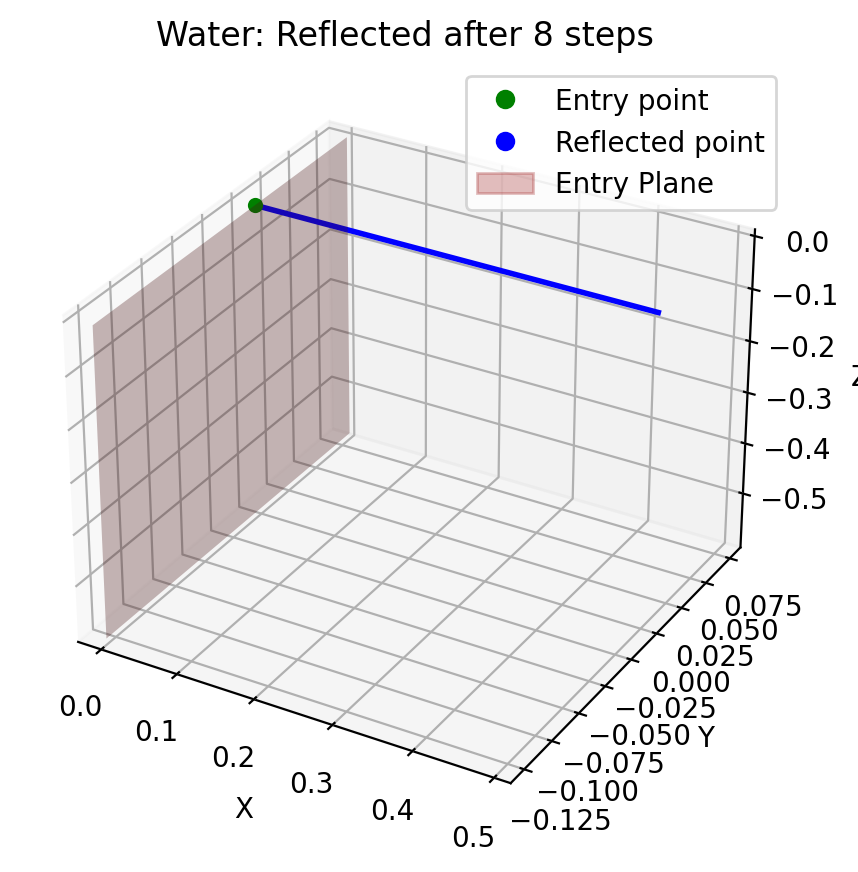

In [ ]:
from matplotlib.animation import FuncAnimation # For creating the animation
from IPython.display import HTML # For displaying the animation in the notebook

DESIRED_ANIMATION_OUTCOME = None
DESIRED_ANIMATION_STEPS_MINIMUM = 0

THICKNESS = 10 # cm
MATERIAL = WATER # The material of the slab

# Run a single Monte Carlo simulation and get the position history and outcome with desired
# settings
outcome = "foo"
position_history = [[],[],[]]
if DESIRED_ANIMATION_OUTCOME and DESIRED_ANIMATION_STEPS_MINIMUM > 0:
  while outcome != DESIRED_ANIMATION_OUTCOME or len(position_history[0]) < DESIRED_ANIMATION_STEPS_MINIMUM:
      outcome, position_history, step_number = single_neutron_1d_mc_with_position_history(MATERIAL, THICKNESS)
else:
  outcome, position_history, step_number = single_neutron_1d_mc_with_position_history(MATERIAL, THICKNESS)

# Determine the axis limits for the plot
x_min, x_max = np.min(position_history[0, :]), np.max(position_history[0, :])
y_min, y_max = np.min(position_history[1, :]), np.max(position_history[1, :])
z_min, z_max = np.min(position_history[2, :]), np.max(position_history[2, :])

# Create a figure
fig = plt.figure(figsize=(5, 5), dpi=200)
ax = fig.add_subplot(1, 1, 1, projection="3d")

def update(frame):
    ax.clear()

    # Plot the trajectory up to the current frame
    ax.plot(position_history[0, :frame+1], position_history[1, :frame+1], position_history[2, :frame+1], color='blue')

    # Define labels and colors for entry and exit points
    start_label = "Entry point"
    end_label = f"{outcome} point"
    start_color = "green"
    end_color = "red" if outcome == "Absorbed" else "blue"

    # Create the legend proxy artists
    green_point = Line2D(
        [0], [0], linestyle="none", marker="o", color="green", label=start_label
    )
    end_point = Line2D(
        [0], [0], linestyle="none", marker="o", color=end_color, label=end_label
    )
    legend_handles = [green_point, end_point]

    # Plot the entry point
    ax.scatter(position_history[0, 0], position_history[1, 0], position_history[2, 0], c=start_color, label=start_label)
    # Plot the exit point if the last frame, otherwise plot the current segment of the trajectory
    if frame == step_number - 1:
        ax.scatter(position_history[0, -1], position_history[1, -1], position_history[2, -1], c=end_color, label=end_label)
        ax.plot(position_history[0, -2:], position_history[1, -2:], position_history[2, -2:], lw=2, color='blue')
    else:
        ax.plot(position_history[0, frame:frame+2], position_history[1, frame:frame+2], position_history[2, frame:frame+2], lw=2, color='blue')

    # Set title, labels, and legend
    ax.set_title(f"{MATERIAL.name}: {outcome} after {step_number} steps")
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.legend()

    # Create a transparent plane parallel to the Y and Z axes at x=0
    yy_entry, zz_entry = np.meshgrid(
        np.linspace(np.min(position_history[1, :]), np.max(position_history[1, :]), 2),
        np.linspace(np.min(position_history[2, :]), np.max(position_history[2, :]), 2),
    )
    ax.plot_surface(0, yy_entry, zz_entry, alpha=0.3, color="brown")
    brown_patch = mpatches.Patch(color="brown", label="Entry Plane", alpha=0.3)
    legend_handles.append(brown_patch)

    # Set axis limits
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)
    ax.set_zlim(z_min, z_max)

    # Add a transparent plane at the end of the slab if the outcome is "Transmitted"
    if outcome == "Transmitted":
        ax.plot_surface(THICKNESS, yy_entry, zz_entry, alpha=0.3, color="yellow")
        orange_patch = mpatches.Patch(color="orange", label="Exit plane", alpha=0.3)
        legend_handles.append(orange_patch)

    ax.legend(handles=legend_handles)

# repeat the last frame 24 times
n_repeat = 24
# create a list of frames
frames = np.concatenate([np.arange(step_number - 1), [step_number-1] * n_repeat])

# Create the animation
ani = FuncAnimation(fig, update, frames=frames, interval=1000)
# Display the animation
HTML(ani.to_jshtml())

The following line saves the animation as an .mp4 file:

In [ ]:
ani.save("neutron_simulation.mp4", writer="ffmpeg", dpi=200, fps=14)

## Spherical Geometry Simulation

Simulating a spherical geometry with a Monte Carlo method for thermal neutrons is a valuable test. Nuclear reactors often contain spherical or cylindrical components, such as fuel elements or control rods. We will consider a hollow sphere with an inner radius and an outer radius. Of particular interest to us is the case in which the material inside the sphere is vacuum, and from inner to outer radius we have one of the materials specified at the start of the notebook. We say that there is no interaction inside the vacuum.

In the previous sections of this notebook, we've deduced that water is the most effective material for preventing thermal neutrons from transmitting. Consequently, we'll simulate a scenario where a neutron originates from a vacuum within a sphere, surrounded by water between the inner and outer radii.

For a sphere with an inner radius of, say, 10 centimeters, we aim to determine the outer radius at which neutron transmission becomes zero.

The simulation is based on the `single_neutron_delta_tracking_1d_mc_with_history` function but has been optimized for speed as the vectorized implementation posed some challenges. The simulation process is as follows:

1. Initialization. The neutron's position is initialized on the sphere's inner radius - say, $r_{\operatorname{inner}}\vec{i}+0\vec{j}+0\vec{k}$. The location on the sphere does not impact the statistical outcome.
2. Direction. When the neutron is on the inner radius, its step direction is always generated perpendicular to the sphere's surface at that point. This is a significant assumption, albeit justified given the water's small mean free path. The step vector's magnitude inside water is sampled conventionally.
3. Interaction. The neutron interacts with water as usual. We now track its position in three dimensions using the norm of its position vector. If it exceeds the outer radius, we record it as transmitted.
4. Re-initialization.  If the neutron's position norm falls below the inner radius (i.e., it has reflected 'back' into the vacuum), we reinitialize it at the sphere's inner radius, and the process begins anew.

Therefore, the only two possible outcomes are reflection and absorption. This implementation offers speed improvements over `single_neutron_delta_tracking_1d_mc_with_history` as it:
- Does not track position history
- Precalculates the norm at the permitted steps
- Uses in-place `np.add` for position updates.

In [ ]:
def single_neutron_hollow_sphere_mc(
    outer_material,
    inner_radius,
    outer_radius,
):
    """
    Simulates the path of a single neutron in a spherical hollow space using a Monte Carlo method.

    The sphere consists of an inner vacuum region and an outer material region. The function simulates
    the neutron's path until it is either absorbed or transmitted through the outer layer of the sphere.

    Parameters:
    outer_material (Material): The material of the outer region of the sphere.
    inner_radius (float): The radius of the inner region of the sphere (i.e., the vacuum).
    outer_radius (float): The radius of the outer region of the sphere (i.e., the material layer).

    Returns:
    str: The outcome of the neutron's path. It can be either "Absorbed" if the neutron is absorbed by the material,
    or "Transmitted" if the neutron exits through the outer layer of the sphere.
    """
    def generate_3d_step(mean_path):
        """
        Generate a 3D step for a random walk with a given mean free path length.

        The function uses isotropic scattering, meaning the step direction is chosen
        uniformly at random from all possible directions. The step length is determined
        by sampling an exponential distribution with the given mean free path.

        Parameters
        ----------
        mean_path : float
            Mean free path length for the random walk step.

        Returns
        -------
        step : numpy.ndarray
            A 3D step vector with shape (3,).
        """
        # Sample random angles for isotropic scattering
        phi = 2 * np.pi * np.random.uniform(low=0, high=1)
        theta = np.arccos(2 * np.random.uniform(low=0, high=1) - 1)

        # Calculate the step length by sampling from an exponential distribution
        # with the given mean free path
        step_length = -mean_path * np.log(np.random.uniform(low=0, high=1))

        # Calculate the 3D step vector using spherical coordinates
        step = step_length * np.array(
            [
                np.sin(theta) * np.cos(phi),
                np.sin(theta) * np.sin(phi),
                np.cos(theta),
            ]
        )

        return step
    # Assume inner material is always vacuum
    inner_material = VACUUM
    smaller_mfp = outer_material.mean_path
    # Initialize position at inner radius
    particle_position = np.array([inner_radius, 0, 0], dtype=np.float64)
    # Initialize step
    current_step = generate_3d_step(smaller_mfp)
    # Unit vector perpendicular to the surface of the inner sphere
    unit_vector = particle_position / np.linalg.norm(particle_position)
    # sample conventionally
    new_step_length = -smaller_mfp * np.log(np.random.uniform(low=0, high=1))
    np.add(particle_position, unit_vector * new_step_length, out=particle_position)

    while True:
        # we use the norm multiple times, so for speed up, precalculate it
        particle_position_norm = np.linalg.norm(particle_position)

        # Determine if the particle is vaccum or not
        in_inner_material = 0 <= particle_position_norm <= inner_radius

        current_material = inner_material if in_inner_material else outer_material

        # Check if the particle is absorbed
        if np.random.uniform(0, 1) < current_material.absorption_probability:
            outcome = "Absorbed"
            break

        # Analogous to fictitious steps, but the particle just gets reinitialized.
        # Position just becomes any point on the surface of the inner material.
        # then, a unit vector is calculated and multiplied by the new step length
        # to add to the position.
        if in_inner_material:
            particle_position = np.array([inner_radius, 0, 0], dtype=np.float64)
            unit_vector = particle_position / particle_position_norm
            new_step_length = -smaller_mfp * np.log(np.random.uniform(low=0, high=1))
            np.add(particle_position, unit_vector * new_step_length, out=particle_position)
        # If in the outer material:
        else:
            current_step = generate_3d_step(smaller_mfp)
            np.add(particle_position, current_step, out=particle_position)
        # Check for transmission with the updated position
        if np.linalg.norm(particle_position) > outer_radius:
            outcome = "Transmitted"
            break
    return outcome


`perform_3d_hollow_sphere_simulations` is an adaptation of a function above for `n_experiments` and `n_entering`:

In [ ]:
def perform_3d_hollow_sphere_simulations(
    inner_radius, outer_radius, outer_material, n_experiments, n_entering, progress_bar=False,
):
    """
    Conducts multiple Monte Carlo simulations of neutron transmission and absorption in a hollow sphere.

    This function simulates the path of neutrons through a hollow sphere with an inner vacuum and an outer material
    layer. It keeps track of the number of neutrons absorbed and transmitted in each experiment and returns the
    results as well as the outcomes of each individual simulation.

    Parameters:
    inner_radius (float): The radius of the inner region of the sphere (i.e., the vacuum).
    outer_radius (float): The radius of the outer region of the sphere (i.e., the material layer).
    outer_material (Material): The material of the outer region of the sphere.
    n_experiments (int): The number of experiments to perform.
    n_entering (int): The number of neutrons entering the sphere in each experiment.
    progress_bar (bool, optional): If True, display a progress bar for the simulations. Default is False.

    Returns:
    tuple: A tuple, containing the mean and standard deviation of the number of neutrons transmitted
    across all experiments. The tuple is in the format (mean, standard deviation).
    """
    # Initialize empty lists to store the results for each experiment
    absorption_results, transmission_results = [], []

    # Create a range object for the experiments
    experiment_range = range(n_experiments)

    # If progress_bar is True, wrap the range object with tqdm
    if progress_bar:
        experiment_range = tqdm(
            experiment_range,
            desc="Experiments with " + str(VACUUM) + " and " + str(outer_material),
            leave=True,
            position=0,
        )
    # Iterate over the experiments
    for _ in experiment_range:
        num_absorbed = num_transmitted  = 0

        # Iterate over the neutrons entering the outer sphere
        for _ in range(n_entering):
            outcome = single_neutron_hollow_sphere_mc(
                outer_material, inner_radius, outer_radius
            )
            if outcome == "Absorbed":
                num_absorbed += 1
            elif outcome == "Transmitted":
                num_transmitted += 1
        assert num_absorbed + num_transmitted == n_entering
        absorption_results.append(num_absorbed)
        transmission_results.append(num_transmitted)
        tqdm._instances.clear()
    # Calculate the mean and standard deviation for transmission
    transmission_mean_std = (
        np.mean(transmission_results) / n_entering,
        np.std(transmission_results) / n_entering,
    )
    assert np.mean(transmission_results) + np.mean(absorption_results) == n_entering

    return transmission_mean_std


Now, we can carry out the experiment (the geometry makes it much more expensive, hence the small `N_EXPERIMENTS` and `N_ENTERING`).

Outer Radius:   0%|          | 0/10 [00:00<?, ?it/s]

With inner radius of 10 cm, transmission becomes zero with zero standard deviation at the outer radius of 34.44 cm.


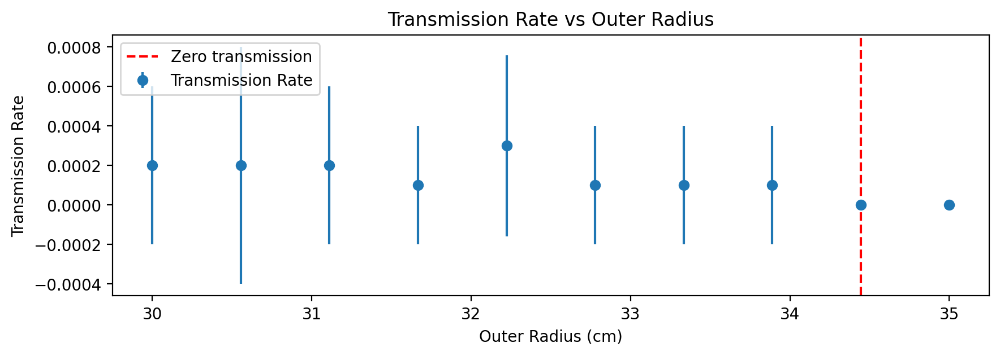

In [ ]:
OUTER_RADII = np.linspace(30, 35, 10)  # cm
INNER_RADIUS = 10  # cm
OUTER_MATERIAL = WATER
N_EXPERIMENTS = 10  # Number of experiments to run to estimate the mean and std
N_ENTERING = 1000  # Neutrons in each experiment

transmission_means = []
transmission_stds = []
zero_transmission_radius = None

for OUTER_RADIUS in tqdm(OUTER_RADII, desc="Outer Radius", leave=True, position=0):
    transmission_mean, transmission_std = perform_3d_hollow_sphere_simulations(
        INNER_RADIUS, OUTER_RADIUS, OUTER_MATERIAL, N_EXPERIMENTS, N_ENTERING
    )
    transmission_means.append(transmission_mean)
    transmission_stds.append(transmission_std)

    # Check if transmission is zero and std is zero, and we haven't found a zero point yet
    if (
        transmission_mean == 0
        and transmission_std == 0
        and zero_transmission_radius is None
    ):
        zero_transmission_radius = OUTER_RADIUS
# Plotting
plt.figure(figsize=(10, 3), dpi=200)
plt.errorbar(
    OUTER_RADII,
    transmission_means,
    yerr=transmission_stds,
    fmt="o",
    label="Transmission Rate",
)
plt.title("Transmission Rate vs Outer Radius")
plt.xlabel("Outer Radius (cm)")
plt.ylabel("Transmission Rate")

# If we found a point where transmission is zero, add a vertical line
if zero_transmission_radius is not None:
    plt.axvline(
        x=zero_transmission_radius, color="r", linestyle="--", label="Zero transmission"
    )
    print(
        f"With inner radius of {INNER_RADIUS} cm, transmission becomes zero with zero standard deviation at the outer radius of {zero_transmission_radius:.2f} cm."
    )
plt.legend()
plt.show()


As expected, results will be quite a bit different than just with a 1D slab due to the geometry - that is, the condition to be transmitted is different.